In [25]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import ndimage as ndi
import torch

from scipy.ndimage import label, generate_binary_structure
from sklearn.metrics.pairwise import euclidean_distances


In [26]:
def iou_score(pred, target):
    smooth = 1e-5

    # Ensure pred and target are NumPy arrays
    if not isinstance(pred, np.ndarray):
        pred = np.array(pred)

    if not isinstance(target, np.ndarray):
        target = np.array(target)

    # Apply threshold to get binary masks
    pred_ = pred > 0.5
    target_ = target > 0.5

    intersection = np.logical_and(pred_, target_).sum()
    union = np.logical_or(pred_, target_).sum()

    return (intersection + smooth) / (union + smooth)


def dice_score_validation(pred, target):
    smooth = 1e-5

    # Flatten the arrays
    pred = pred.flatten()
    target = target.flatten()

    # Apply threshold to get binary masks
    pred = (pred > 0.5).astype(np.float32)
    target = (target > 0.5).astype(np.float32)

    intersection = (pred * target).sum()
    return (2.0 * intersection + smooth) / (pred.sum() + target.sum() + smooth)

In [27]:
os.getcwd()

'/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Segmentation/notebook'

In [28]:
IMAGE_DIR = "/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Preprocessing/data_std_8/Image"
MASK_DIR = "/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Preprocessing/data_std_8/Mask"
CLEAN_DIR_IMG = "/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Preprocessing/data_std_8/Clean/Image"
CLEAN_DIR_MASK = "/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Preprocessing/data_std_8/Clean/Mask"
PREDICT_DIR = "/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Segmentation/Segmentation_output/ViTNetwork_base"
CLEAN_PREDICT_DIR = "/home/nckusoc/Documents/Devin-Journal/LNs/LIDC_IDRI_Segmentation/Segmentation_output/CLEAN_ViTNetwork_base"

In [29]:
pid_list = os.listdir(PREDICT_DIR)[:10]
clean_pid_list = os.listdir(CLEAN_PREDICT_DIR)[:10]

In [30]:
pid_list

['0061_PD_slice095.npy',
 '0892_PD_slice045.npy',
 '0171_PD_slice022.npy',
 '0605_PD_slice056.npy',
 '0770_PD_slice200.npy',
 '0124_PD_slice069.npy',
 '0698_PD_slice340.npy',
 '0359_PD_slice029.npy',
 '0133_PD_slice131.npy',
 '0031_PD_slice116.npy']

In [31]:
clean_pid_list

['0383_CN_slice012.npy',
 '0804_CN_slice004.npy',
 '0548_CN_slice015.npy',
 '0934_CN_slice016.npy',
 '0934_CN_slice005.npy',
 '0646_CN_slice024.npy',
 '0679_CN_slice004.npy',
 '0964_CN_slice044.npy',
 '0441_CN_slice036.npy',
 '0804_CN_slice000.npy']

In [32]:
pid_list[0]

'0061_PD_slice095.npy'

In [7]:
# def center_crop(image, mask, crop_size=256):
#     # Calculate center crop indices
#     center_x, center_y = image.shape[0] // 2, image.shape[1] // 2
#     half_crop = crop_size // 2
#     start_x = center_x - half_crop
#     start_y = center_y - half_crop
#     end_x = center_x + half_crop
#     end_y = center_y + half_crop

#     # Perform cropping
#     image_cropped = image[start_x:end_x, start_y:end_y]
#     mask_cropped = mask[start_x:end_x, start_y:end_y]

#     return image_cropped, mask_cropped

In [33]:
def view_img(MASK_DIR,PREDICT_DIR,IMAGE_DIR):

    for prediction in os.listdir(PREDICT_DIR)[:100]:
        pid = 'LIDC-IDRI-'+prediction[:4]
        mask_id = prediction.replace('PD','MA')
        image_id = prediction.replace('PD','NI')

        original_path = IMAGE_DIR + "/" + pid + "/" + image_id
        mask_path = MASK_DIR + "/" + pid + "/" + mask_id
        predict_path = PREDICT_DIR + "/" + prediction
        print(f"Ori: {image_id}. Mask: {mask_id}. Predict: {prediction}")

        original_img= np.load(original_path)
        mask_img= np.load(mask_path)

        # original_img, mask_img = center_crop(original_img, mask_img)

        predict_mask =np.load(predict_path)

        iou = iou_score(predict_mask, mask_img)
        dice = dice_score_validation(predict_mask, mask_img)

        print(f"IoU: {iou:.4f}, Dice Coefficient: {dice:.4f}")

        fig,ax = plt.subplots(1,3, figsize=(15,15))
        print(pid,prediction)
        ax[0].title.set_text("Original Image")
        ax[0].imshow(original_img, cmap="gray")
        ax[0].axis("off")

        ax[1].title.set_text("Ground Truth Mask")
        ax[1].imshow(mask_img, cmap="gray")
        ax[1].axis("off")

        ax[2].title.set_text("Predicted Mask")
        ax[2].imshow(predict_mask, cmap="gray")
        ax[2].axis("off")

        # Add IoU and Dice scores inside the third plot
        ax[2].text(
            0.5,
            0.1,  # Position: x=0.5 (center), y=0.1 (bottom)
            f"IoU: {iou:.4f}\nDice: {dice:.4f}",
            color="red",
            fontsize=14,
            ha="center",
            va="center",
            transform=ax[2].transAxes,
            bbox=dict(facecolor="white", alpha=0.6, edgecolor="none"),
        )
        # ax[2].grid()
        plt.show()

In [34]:
def view_img_clean(CLEAN_DIR_MASK, CLEAN_PREDICT_DIR, CLEAN_DIR_IMG):

    for prediction in os.listdir(CLEAN_PREDICT_DIR)[:10]:
        pid = "LIDC-IDRI-" + prediction[:4]
        mask_id = prediction.replace("CN", "CM")
        image_id = prediction.replace("CN", "CN")

        original_path = CLEAN_DIR_IMG + "/" + pid + "/" + image_id
        mask_path = CLEAN_DIR_MASK + "/" + pid + "/" + mask_id
        predict_path = CLEAN_PREDICT_DIR + "/" + prediction
        print(f"Ori: {image_id}. Mask: {mask_id}. Predict: {prediction}")

        original_img = np.load(original_path)
        mask_img = np.load(mask_path)

        # original_img, mask_img = center_crop(original_img, mask_img)

        predict_mask = np.load(predict_path)

        iou = iou_score(predict_mask, mask_img)
        dice = dice_score_validation(predict_mask, mask_img)

        print(f"IoU: {iou:.4f}, Dice Coefficient: {dice:.4f}")

        fig, ax = plt.subplots(1, 3, figsize=(15, 15))
        print(pid, prediction)
        ax[0].title.set_text("Original Image")
        ax[0].imshow(original_img, cmap="gray")
        ax[0].axis("off")

        ax[1].title.set_text("Ground Truth Mask")
        ax[1].imshow(mask_img, cmap="gray")
        ax[1].axis("off")

        ax[2].title.set_text("Predicted Mask")
        ax[2].imshow(predict_mask, cmap="gray")
        ax[2].axis("off")

        # Add IoU and Dice scores inside the third plot
        ax[2].text(
            0.5,
            0.1,  # Position: x=0.5 (center), y=0.1 (bottom)
            f"IoU: {iou:.4f}\nDice: {dice:.4f}",
            color="red",
            fontsize=14,
            ha="center",
            va="center",
            transform=ax[2].transAxes,
            bbox=dict(facecolor="white", alpha=0.6, edgecolor="none"),
        )
        # ax[2].grid()
        plt.show()

Ori: 0061_NI_slice095.npy. Mask: 0061_MA_slice095.npy. Predict: 0061_PD_slice095.npy
IoU: 0.3629, Dice Coefficient: 0.5326
LIDC-IDRI-0061 0061_PD_slice095.npy


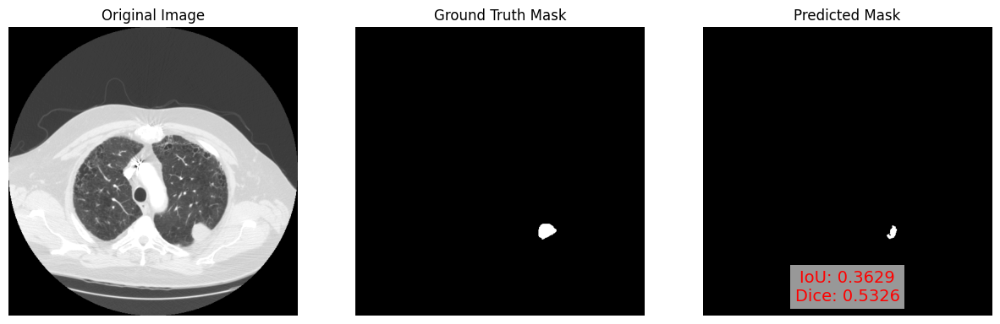

Ori: 0892_NI_slice045.npy. Mask: 0892_MA_slice045.npy. Predict: 0892_PD_slice045.npy
IoU: 0.7652, Dice Coefficient: 0.8670
LIDC-IDRI-0892 0892_PD_slice045.npy


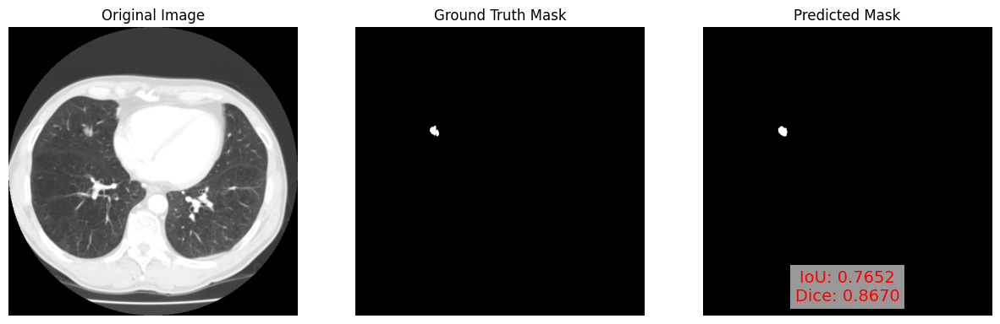

Ori: 0171_NI_slice022.npy. Mask: 0171_MA_slice022.npy. Predict: 0171_PD_slice022.npy
IoU: 0.7652, Dice Coefficient: 0.8670
LIDC-IDRI-0171 0171_PD_slice022.npy


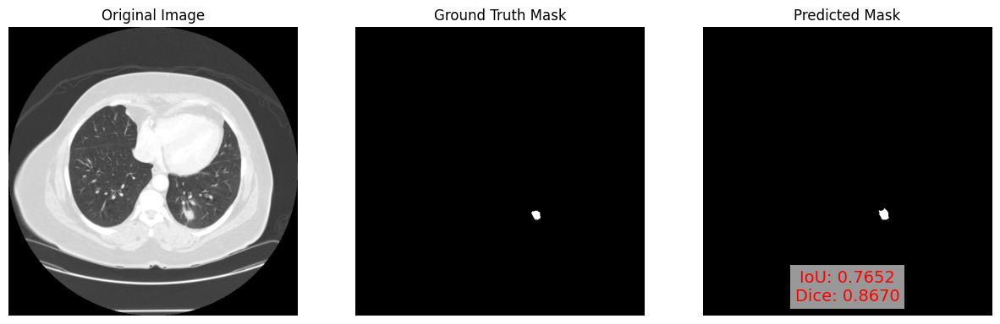

Ori: 0605_NI_slice056.npy. Mask: 0605_MA_slice056.npy. Predict: 0605_PD_slice056.npy
IoU: 0.6222, Dice Coefficient: 0.7671
LIDC-IDRI-0605 0605_PD_slice056.npy


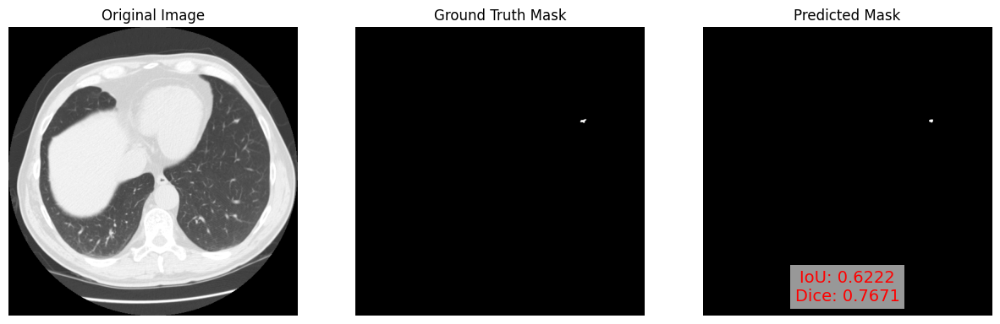

Ori: 0770_NI_slice200.npy. Mask: 0770_MA_slice200.npy. Predict: 0770_PD_slice200.npy
IoU: 0.8876, Dice Coefficient: 0.9405
LIDC-IDRI-0770 0770_PD_slice200.npy


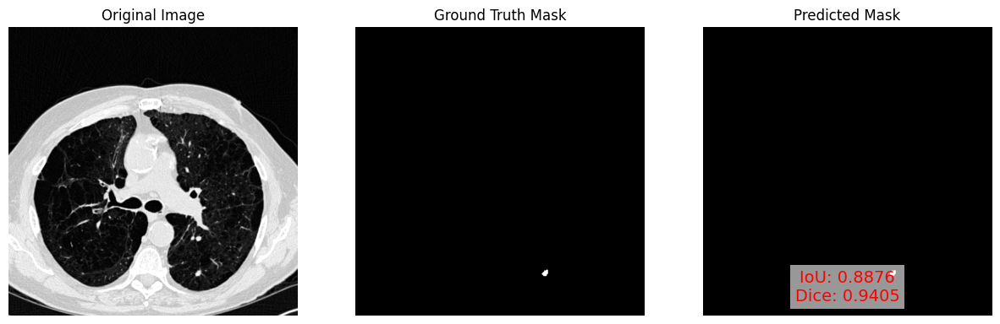

Ori: 0124_NI_slice069.npy. Mask: 0124_MA_slice069.npy. Predict: 0124_PD_slice069.npy
IoU: 0.9469, Dice Coefficient: 0.9727
LIDC-IDRI-0124 0124_PD_slice069.npy


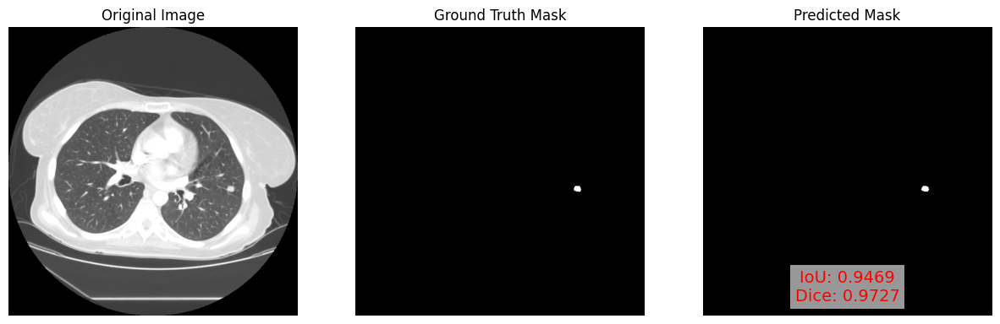

Ori: 0698_NI_slice340.npy. Mask: 0698_MA_slice340.npy. Predict: 0698_PD_slice340.npy
IoU: 0.6364, Dice Coefficient: 0.7778
LIDC-IDRI-0698 0698_PD_slice340.npy


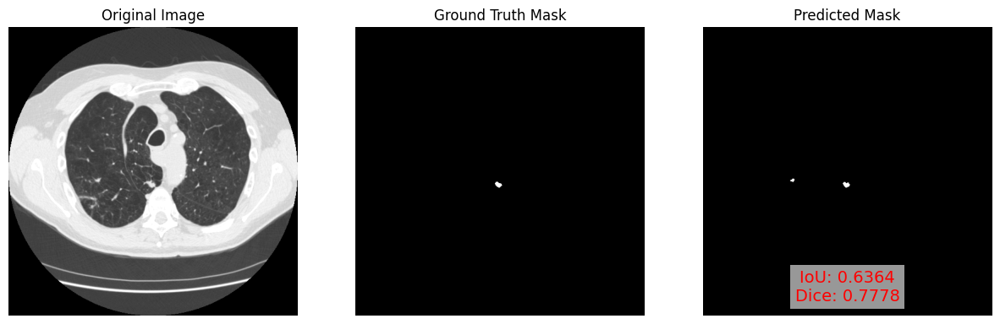

Ori: 0359_NI_slice029.npy. Mask: 0359_MA_slice029.npy. Predict: 0359_PD_slice029.npy
IoU: 0.7556, Dice Coefficient: 0.8608
LIDC-IDRI-0359 0359_PD_slice029.npy


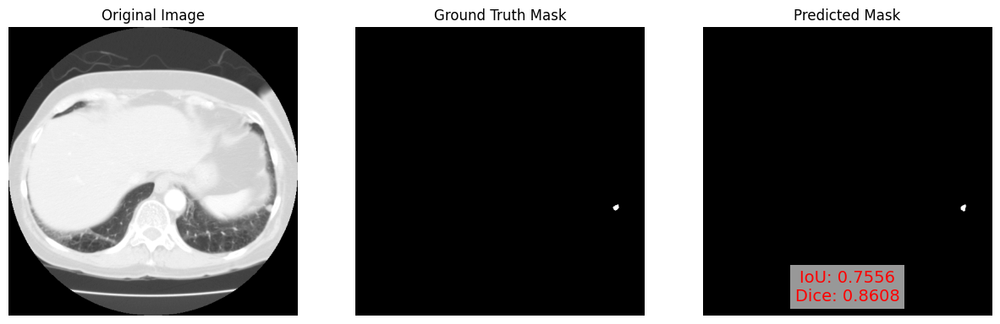

Ori: 0133_NI_slice131.npy. Mask: 0133_MA_slice131.npy. Predict: 0133_PD_slice131.npy
IoU: 0.7674, Dice Coefficient: 0.8684
LIDC-IDRI-0133 0133_PD_slice131.npy


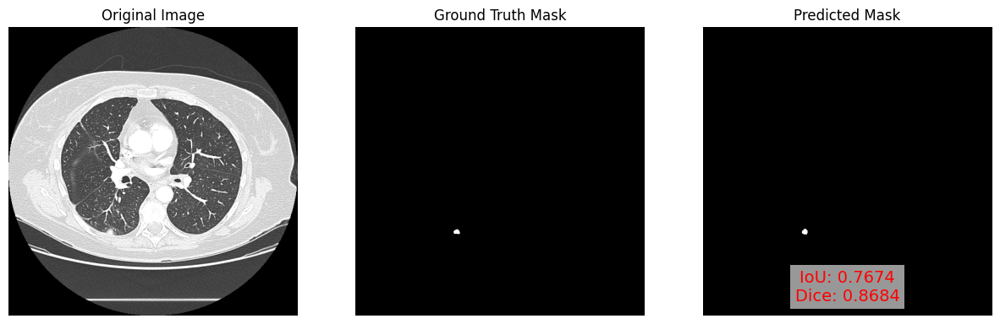

Ori: 0031_NI_slice116.npy. Mask: 0031_MA_slice116.npy. Predict: 0031_PD_slice116.npy
IoU: 0.8816, Dice Coefficient: 0.9371
LIDC-IDRI-0031 0031_PD_slice116.npy


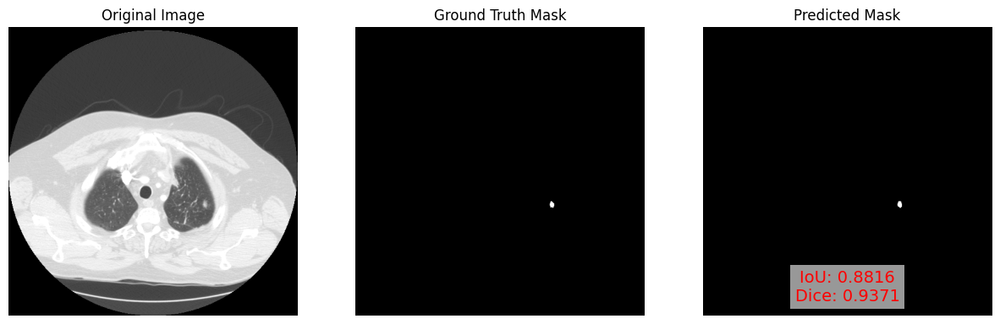

Ori: 0298_NI_slice287.npy. Mask: 0298_MA_slice287.npy. Predict: 0298_PD_slice287.npy
IoU: 0.4444, Dice Coefficient: 0.6154
LIDC-IDRI-0298 0298_PD_slice287.npy


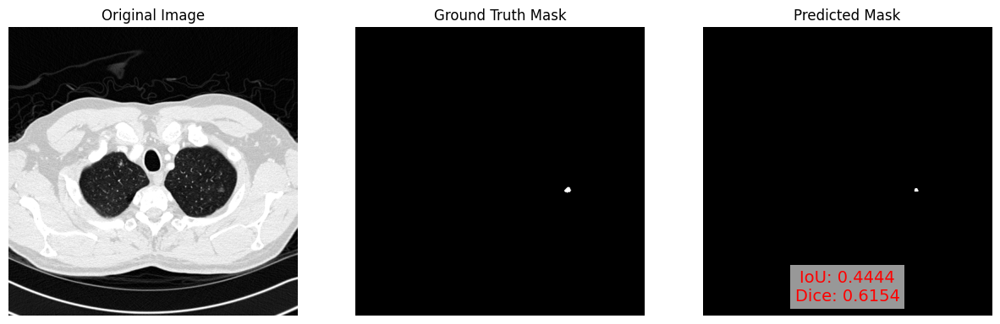

Ori: 0698_NI_slice360.npy. Mask: 0698_MA_slice360.npy. Predict: 0698_PD_slice360.npy
IoU: 0.7167, Dice Coefficient: 0.8350
LIDC-IDRI-0698 0698_PD_slice360.npy


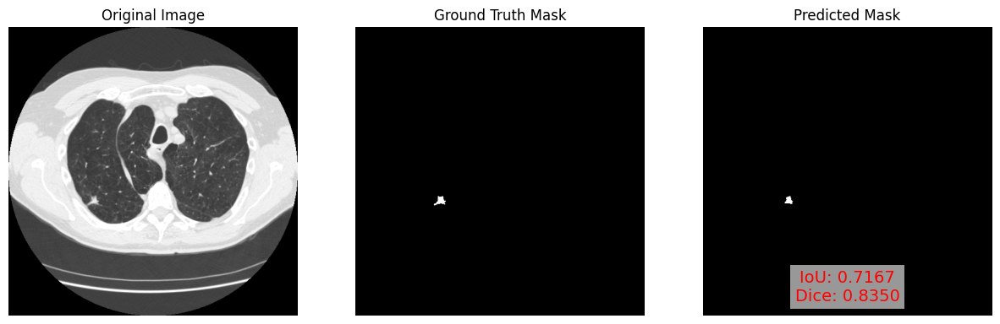

Ori: 0207_NI_slice065.npy. Mask: 0207_MA_slice065.npy. Predict: 0207_PD_slice065.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0207 0207_PD_slice065.npy


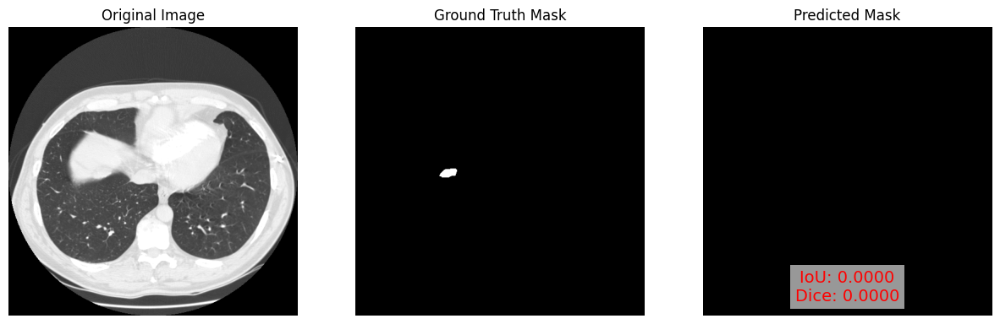

Ori: 0094_NI_slice301.npy. Mask: 0094_MA_slice301.npy. Predict: 0094_PD_slice301.npy
IoU: 0.8814, Dice Coefficient: 0.9370
LIDC-IDRI-0094 0094_PD_slice301.npy


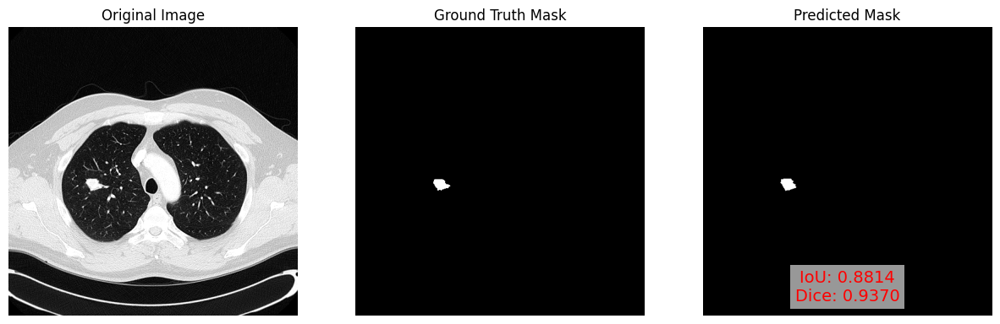

Ori: 0359_NI_slice028.npy. Mask: 0359_MA_slice028.npy. Predict: 0359_PD_slice028.npy
IoU: 0.8352, Dice Coefficient: 0.9102
LIDC-IDRI-0359 0359_PD_slice028.npy


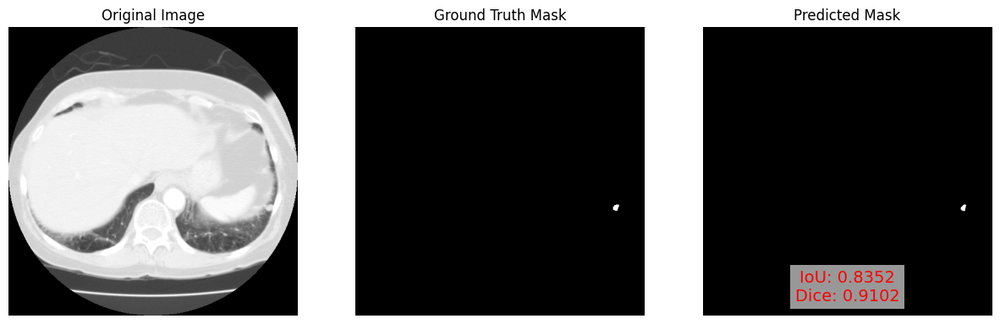

Ori: 0124_NI_slice082.npy. Mask: 0124_MA_slice082.npy. Predict: 0124_PD_slice082.npy
IoU: 0.7879, Dice Coefficient: 0.8814
LIDC-IDRI-0124 0124_PD_slice082.npy


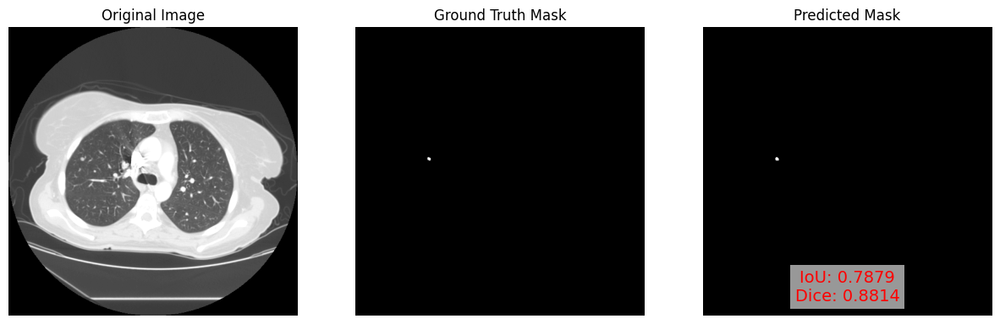

Ori: 0207_NI_slice066.npy. Mask: 0207_MA_slice066.npy. Predict: 0207_PD_slice066.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0207 0207_PD_slice066.npy


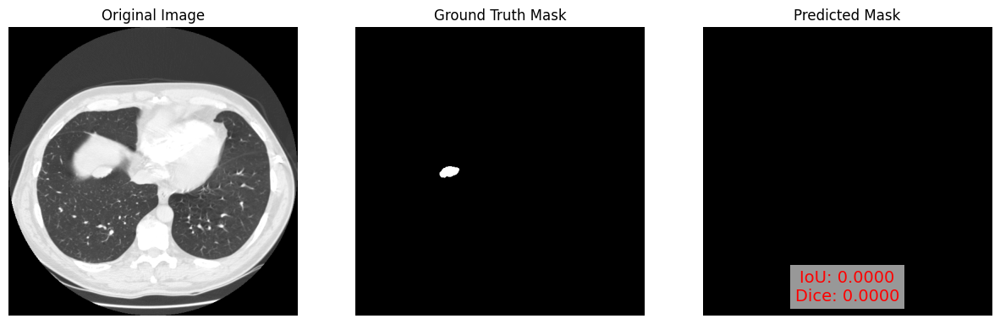

Ori: 0049_NI_slice072.npy. Mask: 0049_MA_slice072.npy. Predict: 0049_PD_slice072.npy
IoU: 0.3932, Dice Coefficient: 0.5644
LIDC-IDRI-0049 0049_PD_slice072.npy


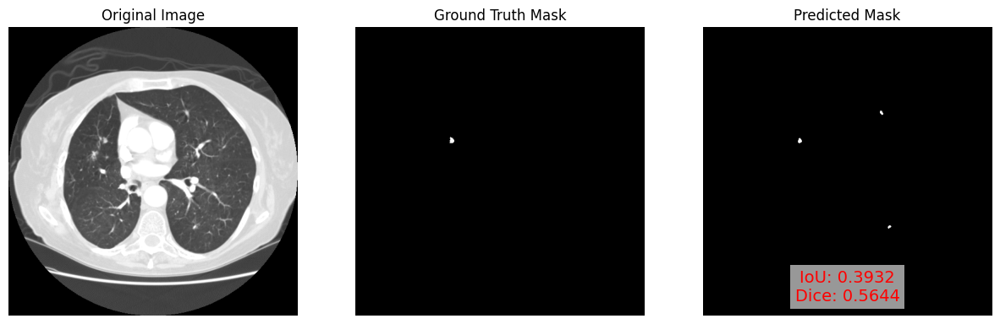

Ori: 0091_NI_slice155.npy. Mask: 0091_MA_slice155.npy. Predict: 0091_PD_slice155.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0091 0091_PD_slice155.npy


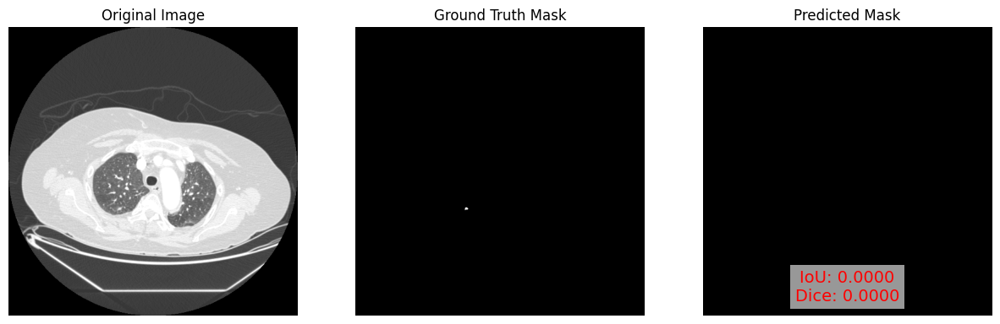

Ori: 0867_NI_slice280.npy. Mask: 0867_MA_slice280.npy. Predict: 0867_PD_slice280.npy
IoU: 0.7647, Dice Coefficient: 0.8667
LIDC-IDRI-0867 0867_PD_slice280.npy


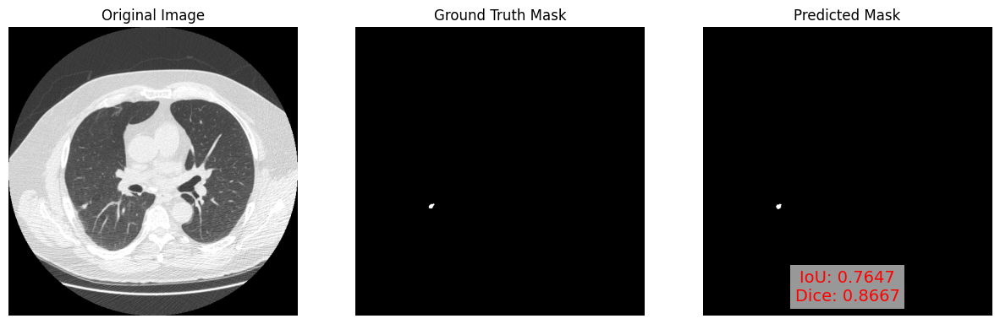

Ori: 0770_NI_slice235.npy. Mask: 0770_MA_slice235.npy. Predict: 0770_PD_slice235.npy
IoU: 0.7609, Dice Coefficient: 0.8642
LIDC-IDRI-0770 0770_PD_slice235.npy


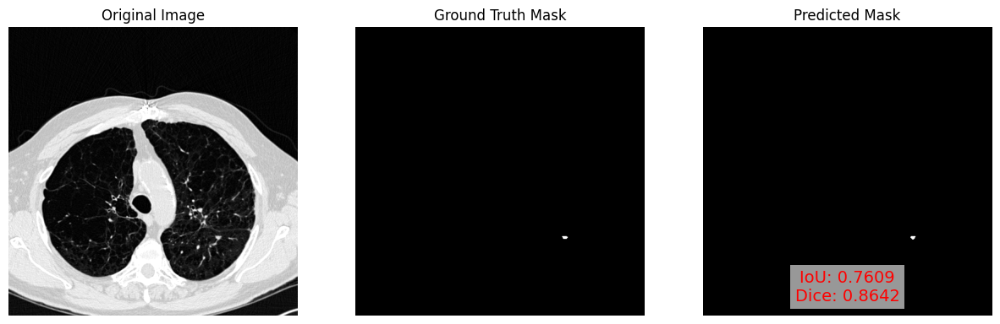

Ori: 0159_NI_slice072.npy. Mask: 0159_MA_slice072.npy. Predict: 0159_PD_slice072.npy
IoU: 0.9474, Dice Coefficient: 0.9730
LIDC-IDRI-0159 0159_PD_slice072.npy


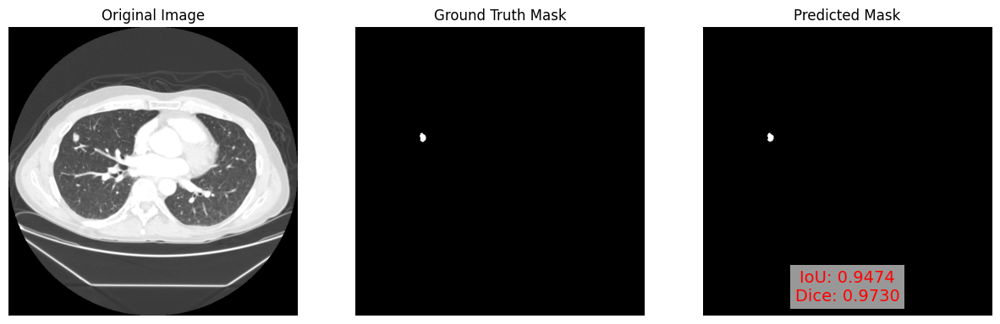

Ori: 0347_NI_slice070.npy. Mask: 0347_MA_slice070.npy. Predict: 0347_PD_slice070.npy
IoU: 0.8690, Dice Coefficient: 0.9299
LIDC-IDRI-0347 0347_PD_slice070.npy


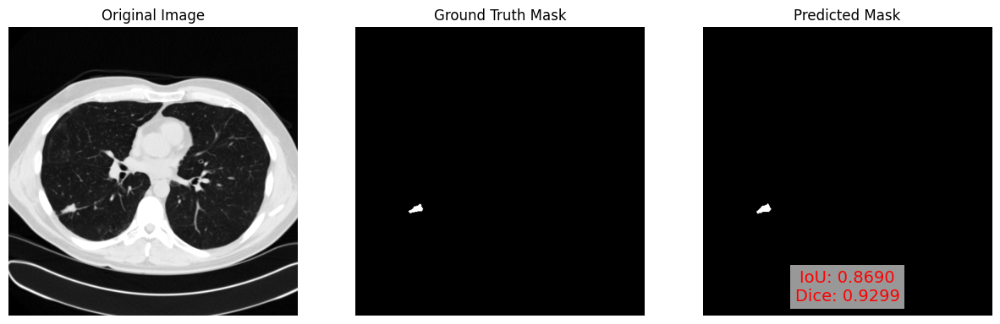

Ori: 0298_NI_slice249.npy. Mask: 0298_MA_slice249.npy. Predict: 0298_PD_slice249.npy
IoU: 0.6825, Dice Coefficient: 0.8113
LIDC-IDRI-0298 0298_PD_slice249.npy


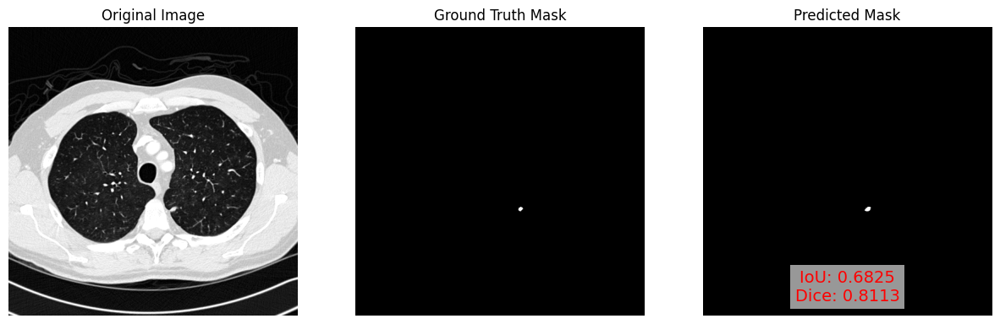

Ori: 0031_NI_slice088.npy. Mask: 0031_MA_slice088.npy. Predict: 0031_PD_slice088.npy
IoU: 0.7759, Dice Coefficient: 0.8738
LIDC-IDRI-0031 0031_PD_slice088.npy


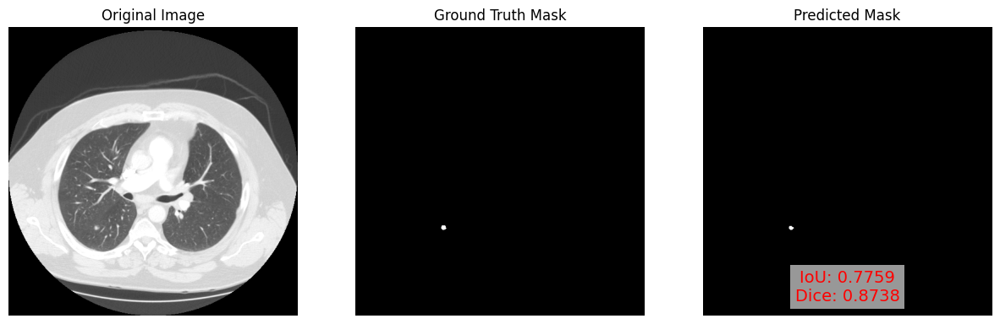

Ori: 0709_NI_slice067.npy. Mask: 0709_MA_slice067.npy. Predict: 0709_PD_slice067.npy
IoU: 0.8162, Dice Coefficient: 0.8988
LIDC-IDRI-0709 0709_PD_slice067.npy


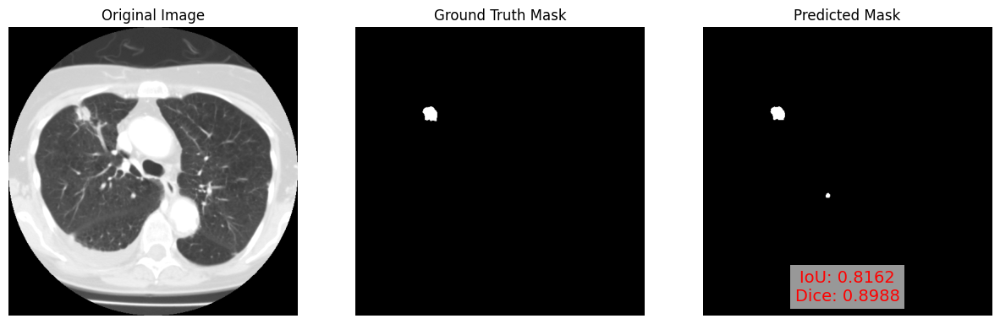

Ori: 0713_NI_slice033.npy. Mask: 0713_MA_slice033.npy. Predict: 0713_PD_slice033.npy
IoU: 0.7059, Dice Coefficient: 0.8276
LIDC-IDRI-0713 0713_PD_slice033.npy


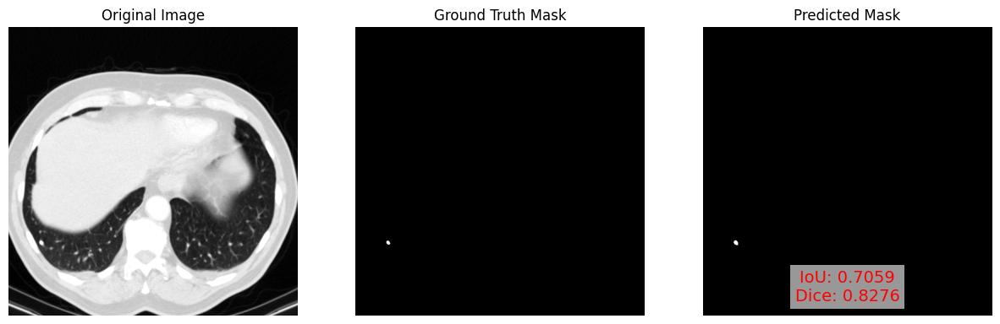

Ori: 0119_NI_slice196.npy. Mask: 0119_MA_slice196.npy. Predict: 0119_PD_slice196.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0119 0119_PD_slice196.npy


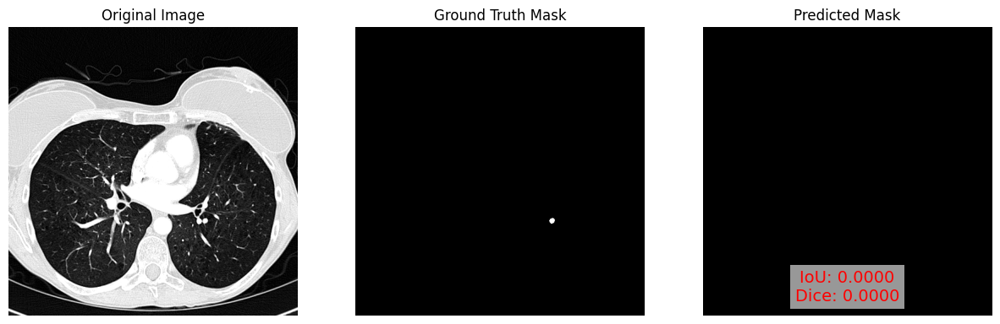

Ori: 0116_NI_slice103.npy. Mask: 0116_MA_slice103.npy. Predict: 0116_PD_slice103.npy
IoU: 0.9259, Dice Coefficient: 0.9615
LIDC-IDRI-0116 0116_PD_slice103.npy


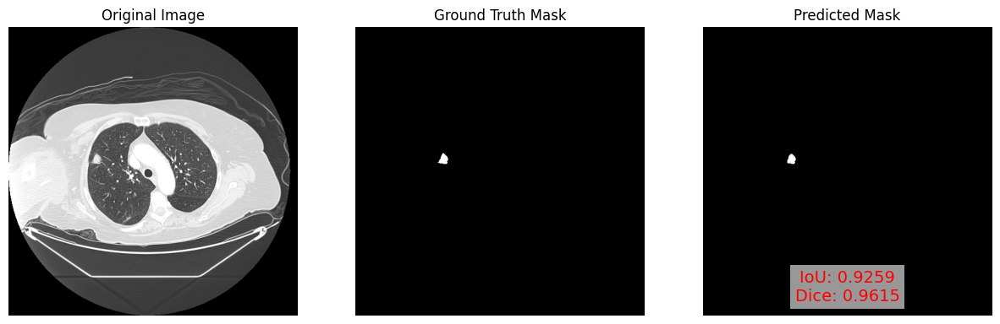

Ori: 0139_NI_slice042.npy. Mask: 0139_MA_slice042.npy. Predict: 0139_PD_slice042.npy
IoU: 0.8111, Dice Coefficient: 0.8957
LIDC-IDRI-0139 0139_PD_slice042.npy


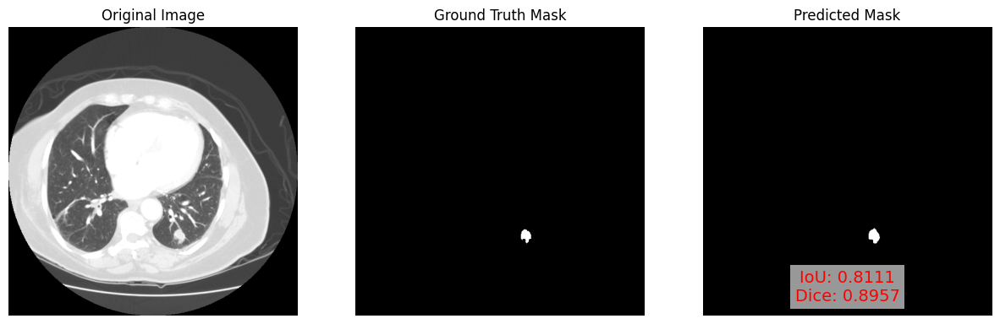

Ori: 0698_NI_slice350.npy. Mask: 0698_MA_slice350.npy. Predict: 0698_PD_slice350.npy
IoU: 0.5263, Dice Coefficient: 0.6897
LIDC-IDRI-0698 0698_PD_slice350.npy


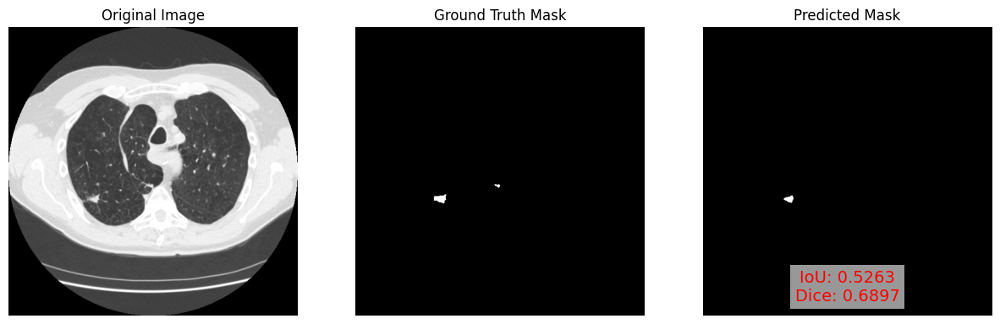

Ori: 0298_NI_slice286.npy. Mask: 0298_MA_slice286.npy. Predict: 0298_PD_slice286.npy
IoU: 0.4405, Dice Coefficient: 0.6116
LIDC-IDRI-0298 0298_PD_slice286.npy


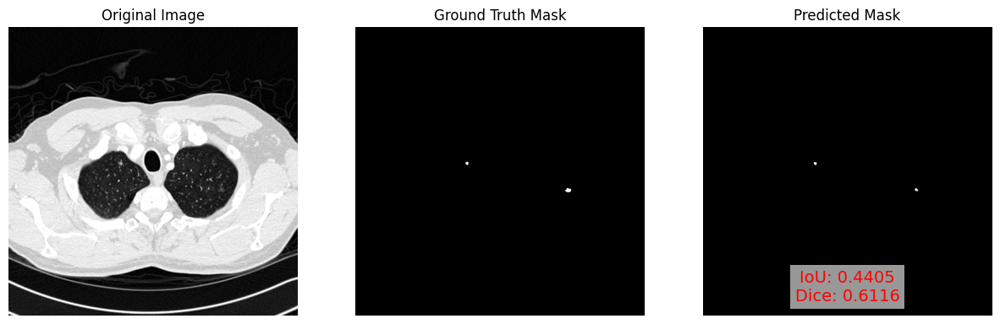

Ori: 0709_NI_slice073.npy. Mask: 0709_MA_slice073.npy. Predict: 0709_PD_slice073.npy
IoU: 0.4818, Dice Coefficient: 0.6503
LIDC-IDRI-0709 0709_PD_slice073.npy


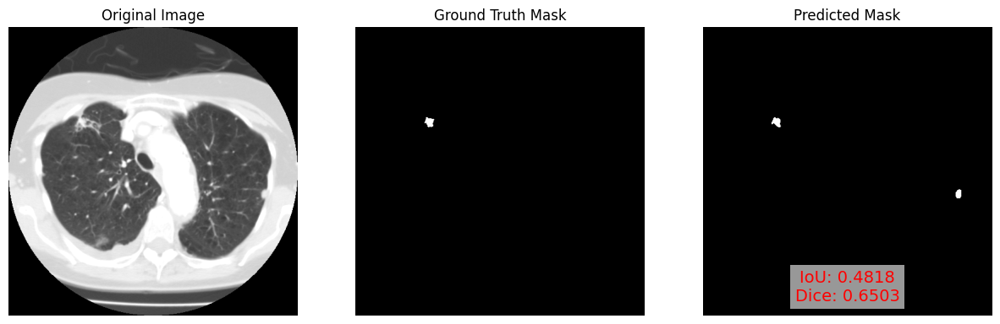

Ori: 0262_NI_slice111.npy. Mask: 0262_MA_slice111.npy. Predict: 0262_PD_slice111.npy
IoU: 0.7724, Dice Coefficient: 0.8716
LIDC-IDRI-0262 0262_PD_slice111.npy


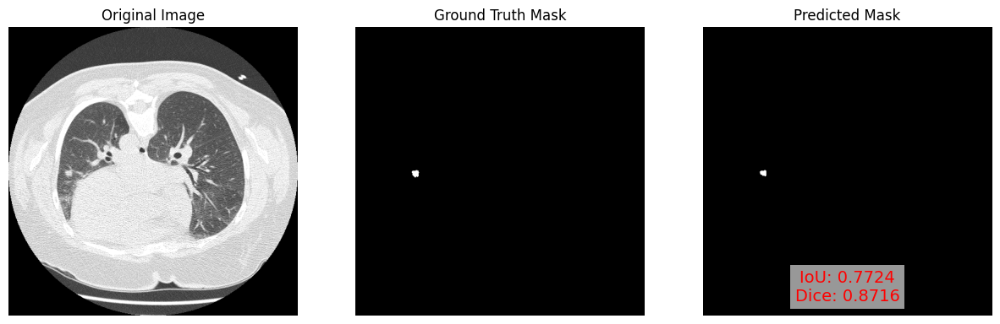

Ori: 0077_NI_slice076.npy. Mask: 0077_MA_slice076.npy. Predict: 0077_PD_slice076.npy
IoU: 0.5419, Dice Coefficient: 0.7029
LIDC-IDRI-0077 0077_PD_slice076.npy


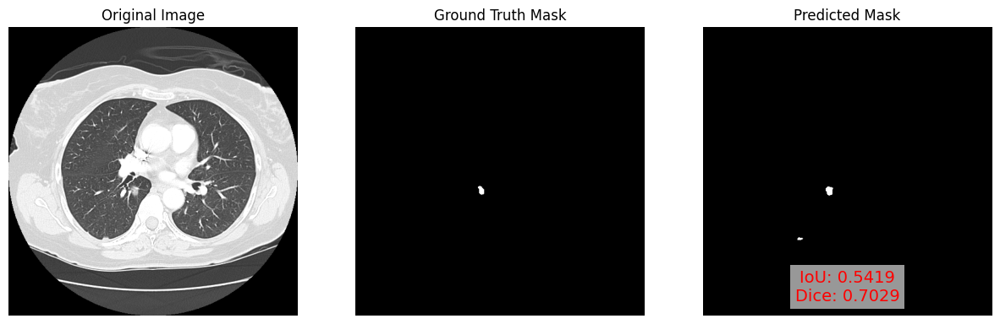

Ori: 0108_NI_slice041.npy. Mask: 0108_MA_slice041.npy. Predict: 0108_PD_slice041.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0108 0108_PD_slice041.npy


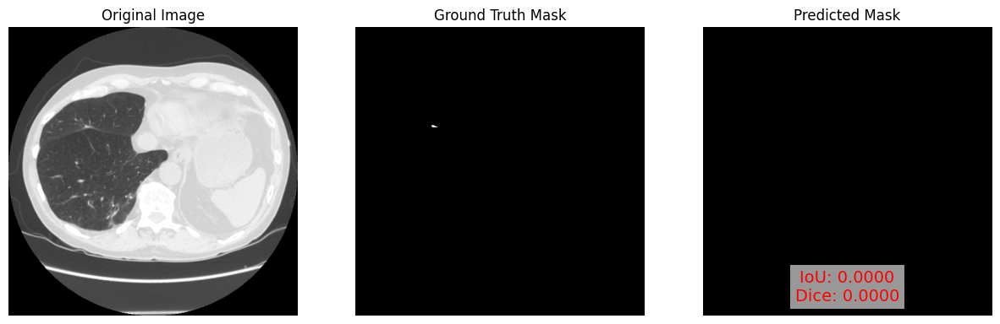

Ori: 0713_NI_slice095.npy. Mask: 0713_MA_slice095.npy. Predict: 0713_PD_slice095.npy
IoU: 0.8188, Dice Coefficient: 0.9004
LIDC-IDRI-0713 0713_PD_slice095.npy


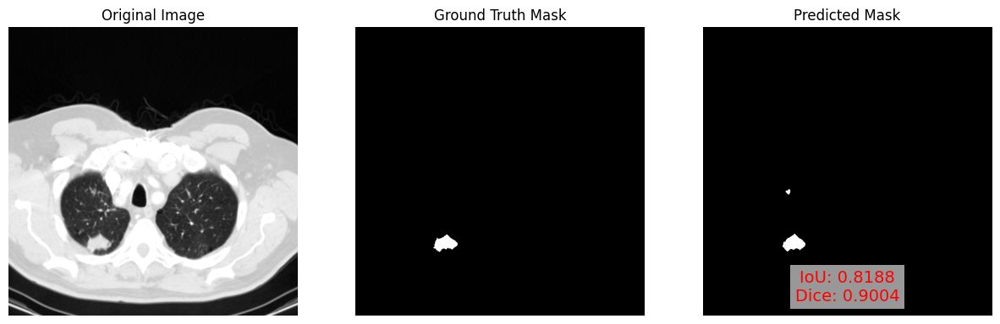

Ori: 0770_NI_slice234.npy. Mask: 0770_MA_slice234.npy. Predict: 0770_PD_slice234.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0770 0770_PD_slice234.npy


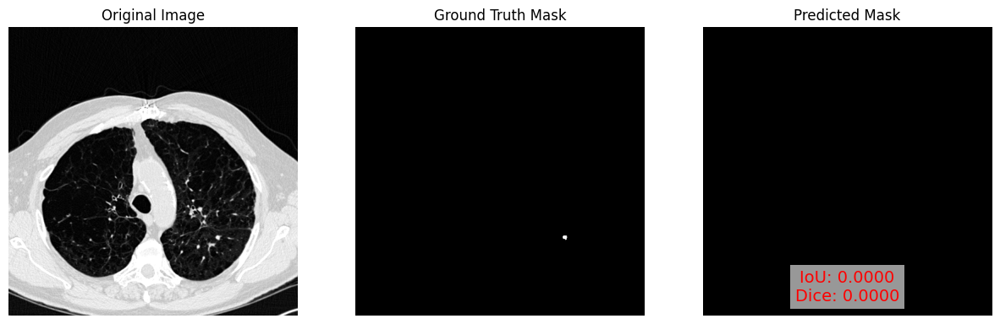

Ori: 0386_NI_slice354.npy. Mask: 0386_MA_slice354.npy. Predict: 0386_PD_slice354.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0386 0386_PD_slice354.npy


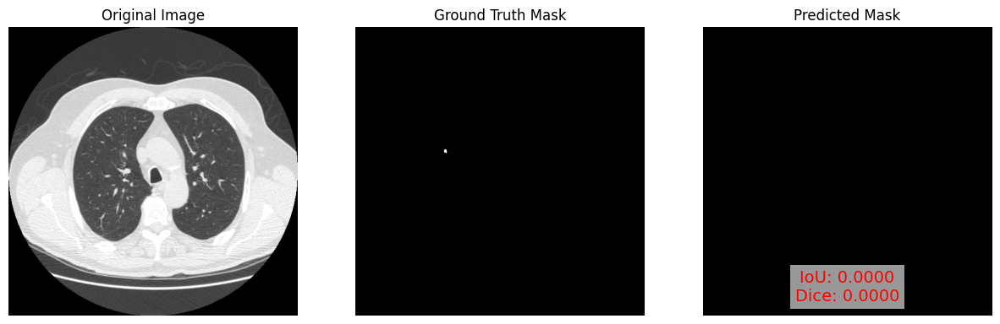

Ori: 0139_NI_slice028.npy. Mask: 0139_MA_slice028.npy. Predict: 0139_PD_slice028.npy
IoU: 0.4680, Dice Coefficient: 0.6376
LIDC-IDRI-0139 0139_PD_slice028.npy


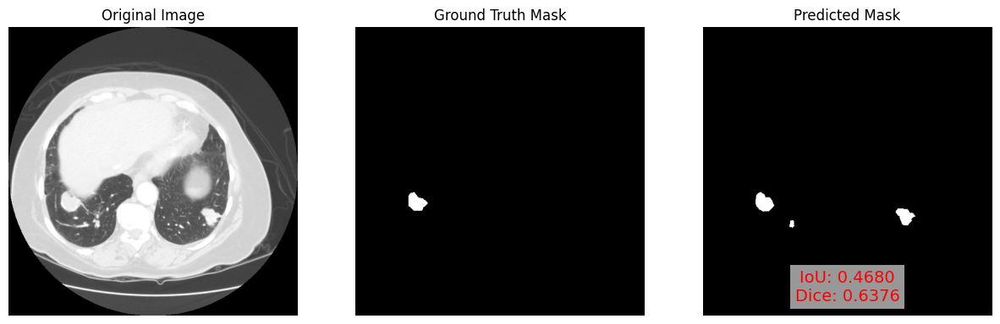

Ori: 0811_NI_slice251.npy. Mask: 0811_MA_slice251.npy. Predict: 0811_PD_slice251.npy
IoU: 0.5235, Dice Coefficient: 0.6872
LIDC-IDRI-0811 0811_PD_slice251.npy


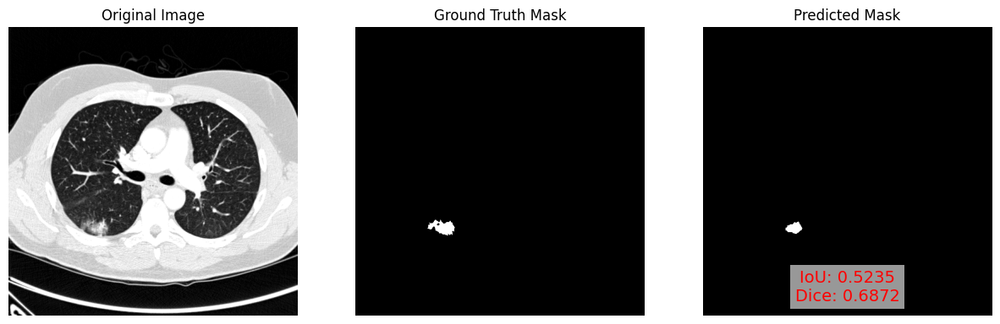

Ori: 0811_NI_slice254.npy. Mask: 0811_MA_slice254.npy. Predict: 0811_PD_slice254.npy
IoU: 0.2049, Dice Coefficient: 0.3401
LIDC-IDRI-0811 0811_PD_slice254.npy


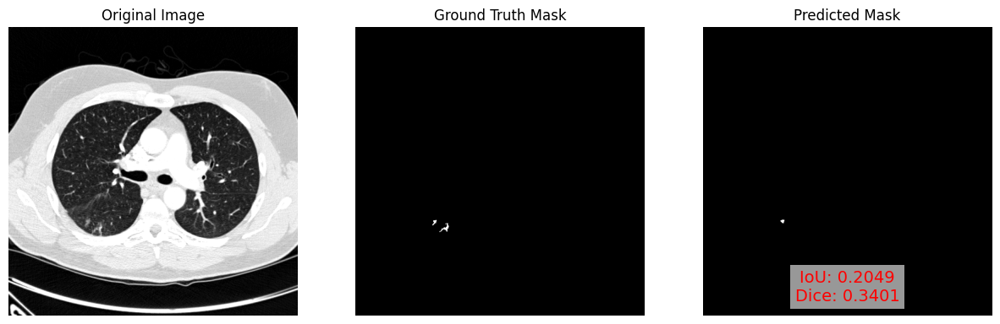

Ori: 0713_NI_slice097.npy. Mask: 0713_MA_slice097.npy. Predict: 0713_PD_slice097.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0713 0713_PD_slice097.npy


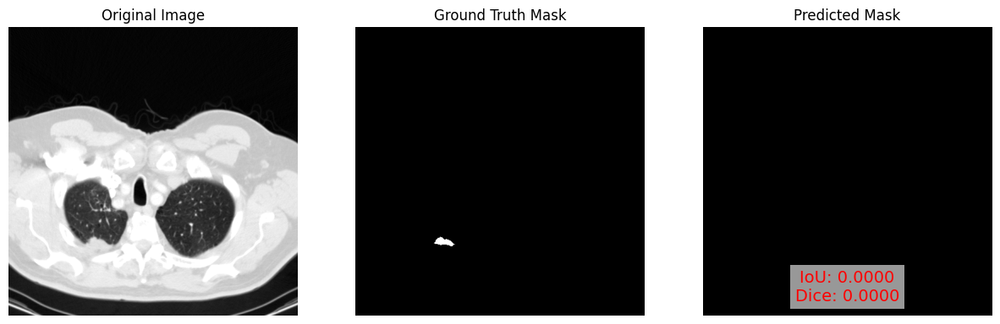

Ori: 0811_NI_slice238.npy. Mask: 0811_MA_slice238.npy. Predict: 0811_PD_slice238.npy
IoU: 0.6880, Dice Coefficient: 0.8152
LIDC-IDRI-0811 0811_PD_slice238.npy


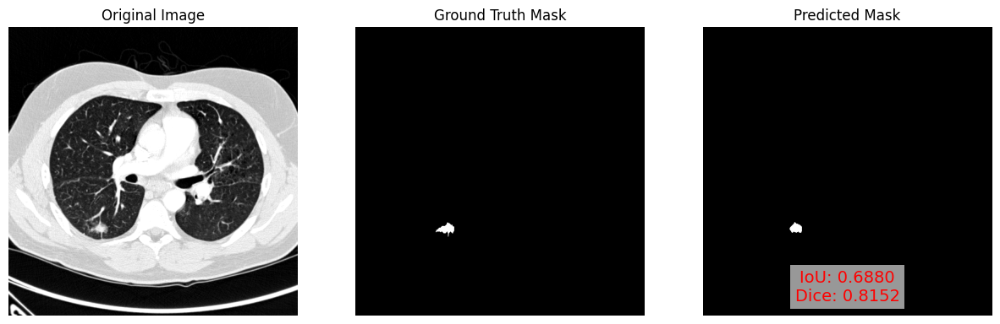

Ori: 0356_NI_slice075.npy. Mask: 0356_MA_slice075.npy. Predict: 0356_PD_slice075.npy
IoU: 0.9192, Dice Coefficient: 0.9579
LIDC-IDRI-0356 0356_PD_slice075.npy


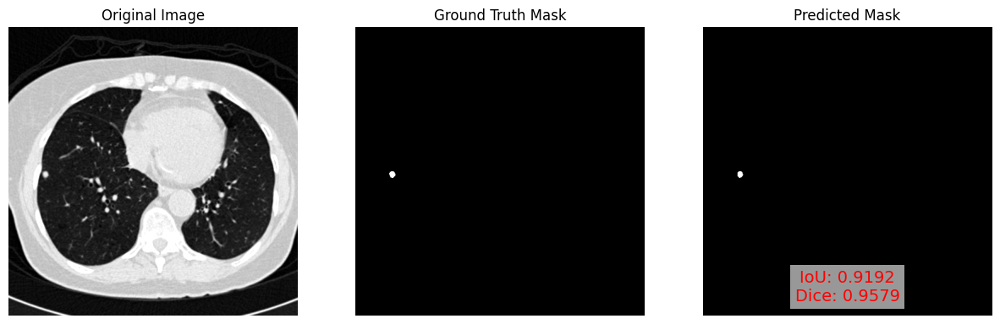

Ori: 0091_NI_slice161.npy. Mask: 0091_MA_slice161.npy. Predict: 0091_PD_slice161.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0091 0091_PD_slice161.npy


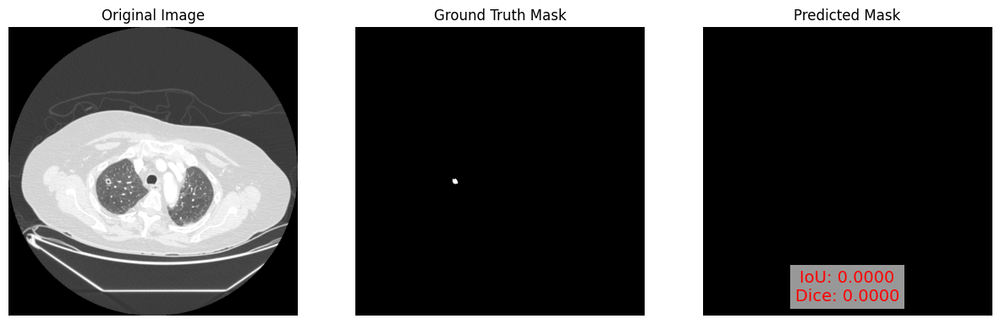

Ori: 0031_NI_slice114.npy. Mask: 0031_MA_slice114.npy. Predict: 0031_PD_slice114.npy
IoU: 0.8681, Dice Coefficient: 0.9294
LIDC-IDRI-0031 0031_PD_slice114.npy


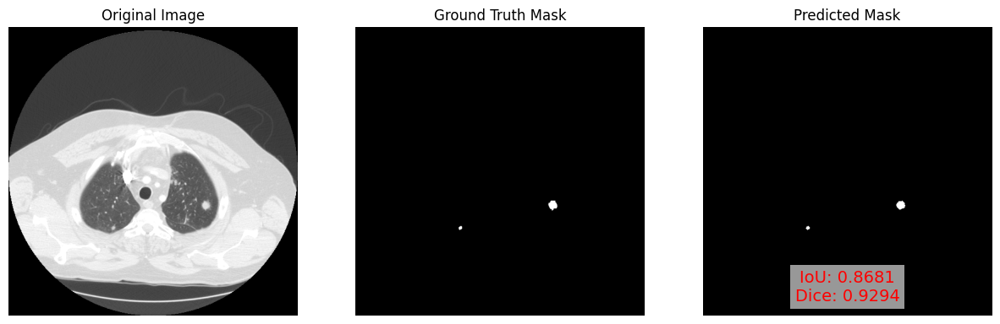

Ori: 0772_NI_slice110.npy. Mask: 0772_MA_slice110.npy. Predict: 0772_PD_slice110.npy
IoU: 0.8929, Dice Coefficient: 0.9434
LIDC-IDRI-0772 0772_PD_slice110.npy


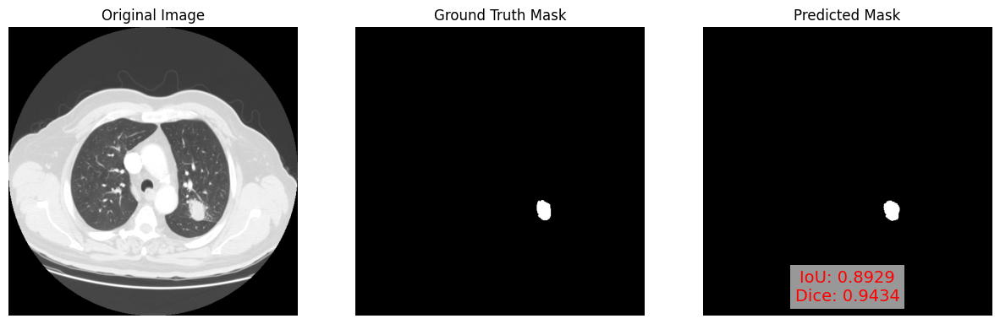

Ori: 0484_NI_slice038.npy. Mask: 0484_MA_slice038.npy. Predict: 0484_PD_slice038.npy
IoU: 0.3134, Dice Coefficient: 0.4773
LIDC-IDRI-0484 0484_PD_slice038.npy


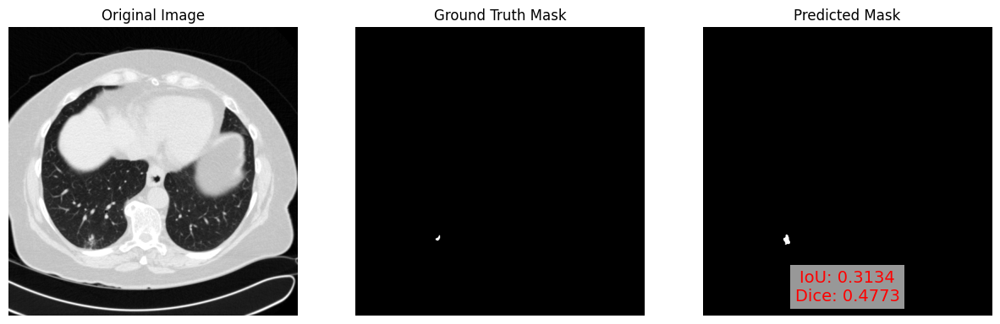

Ori: 0130_NI_slice113.npy. Mask: 0130_MA_slice113.npy. Predict: 0130_PD_slice113.npy
IoU: 0.1171, Dice Coefficient: 0.2096
LIDC-IDRI-0130 0130_PD_slice113.npy


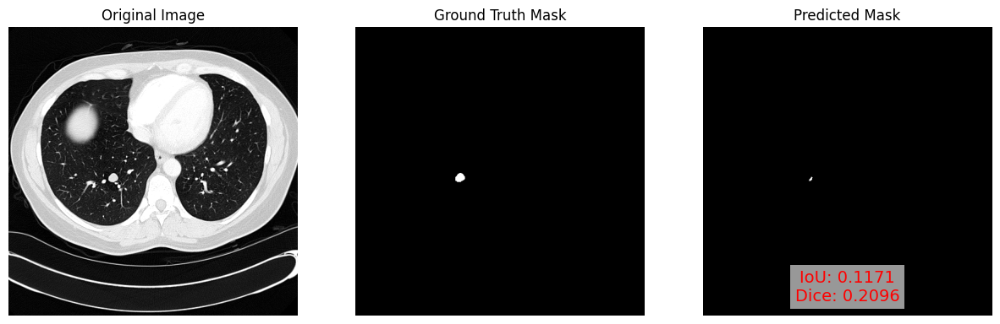

Ori: 0433_NI_slice161.npy. Mask: 0433_MA_slice161.npy. Predict: 0433_PD_slice161.npy
IoU: 0.8605, Dice Coefficient: 0.9250
LIDC-IDRI-0433 0433_PD_slice161.npy


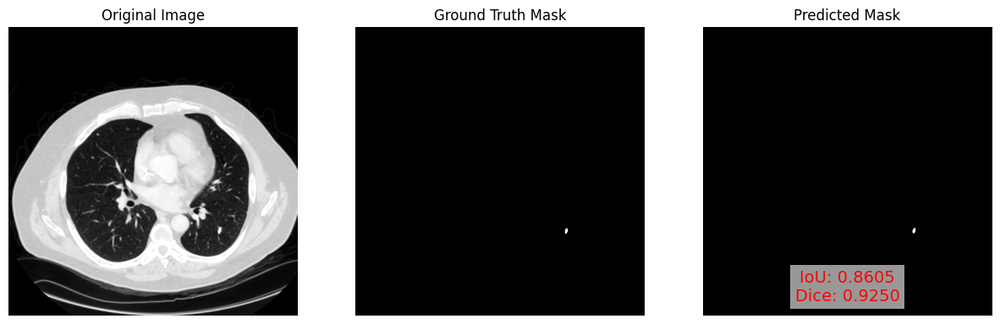

Ori: 0094_NI_slice304.npy. Mask: 0094_MA_slice304.npy. Predict: 0094_PD_slice304.npy
IoU: 0.8657, Dice Coefficient: 0.9280
LIDC-IDRI-0094 0094_PD_slice304.npy


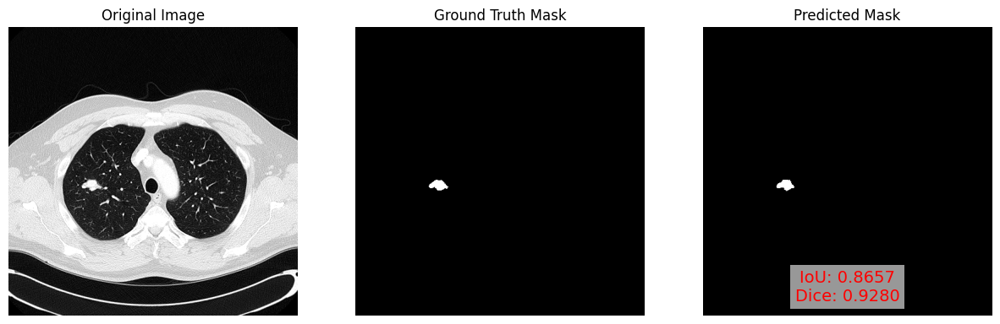

Ori: 0504_NI_slice058.npy. Mask: 0504_MA_slice058.npy. Predict: 0504_PD_slice058.npy
IoU: 0.6920, Dice Coefficient: 0.8179
LIDC-IDRI-0504 0504_PD_slice058.npy


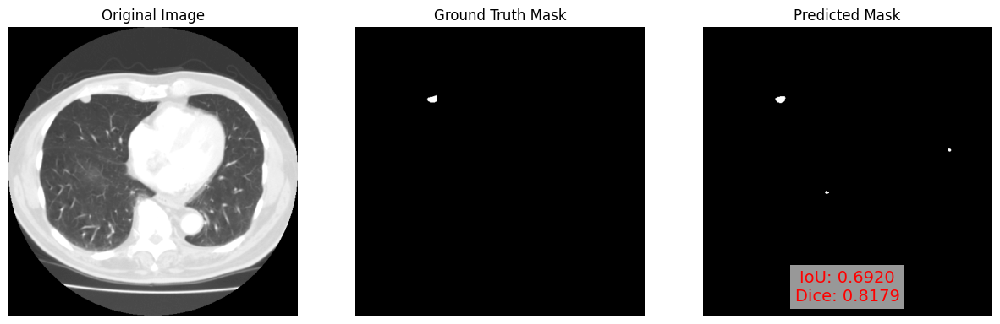

Ori: 0108_NI_slice044.npy. Mask: 0108_MA_slice044.npy. Predict: 0108_PD_slice044.npy
IoU: 0.9053, Dice Coefficient: 0.9503
LIDC-IDRI-0108 0108_PD_slice044.npy


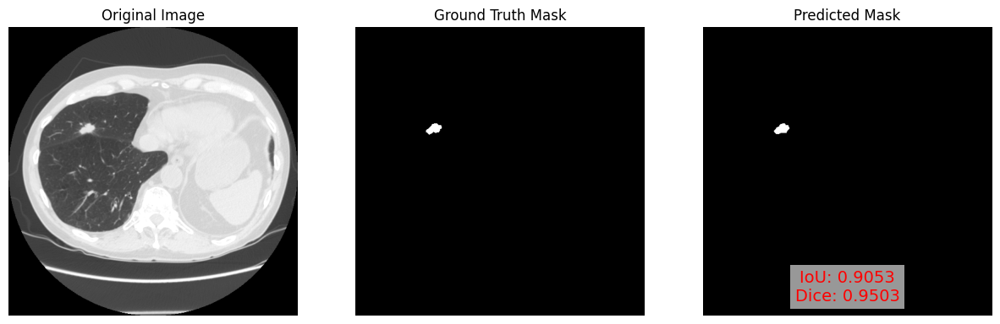

Ori: 0116_NI_slice100.npy. Mask: 0116_MA_slice100.npy. Predict: 0116_PD_slice100.npy
IoU: 0.8880, Dice Coefficient: 0.9407
LIDC-IDRI-0116 0116_PD_slice100.npy


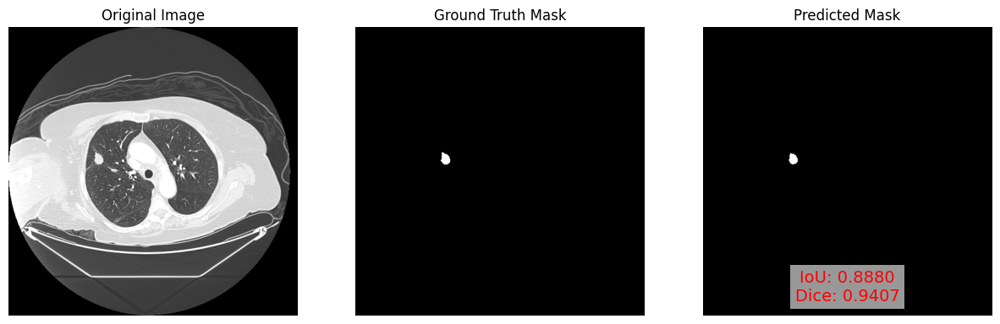

Ori: 0386_NI_slice356.npy. Mask: 0386_MA_slice356.npy. Predict: 0386_PD_slice356.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0386 0386_PD_slice356.npy


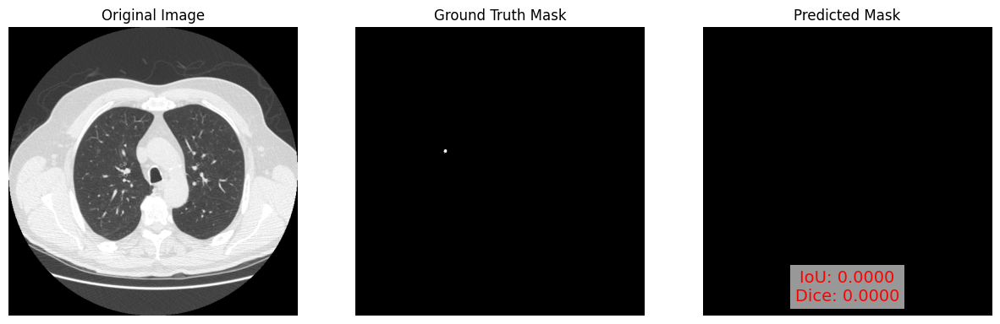

Ori: 0298_NI_slice247.npy. Mask: 0298_MA_slice247.npy. Predict: 0298_PD_slice247.npy
IoU: 0.8235, Dice Coefficient: 0.9032
LIDC-IDRI-0298 0298_PD_slice247.npy


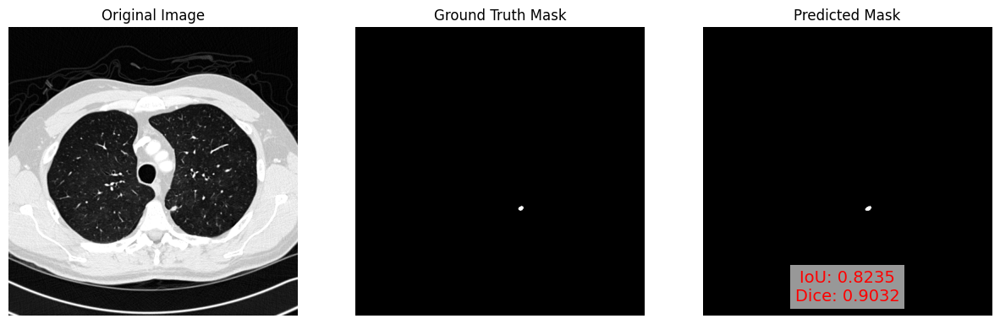

Ori: 0094_NI_slice296.npy. Mask: 0094_MA_slice296.npy. Predict: 0094_PD_slice296.npy
IoU: 0.7412, Dice Coefficient: 0.8514
LIDC-IDRI-0094 0094_PD_slice296.npy


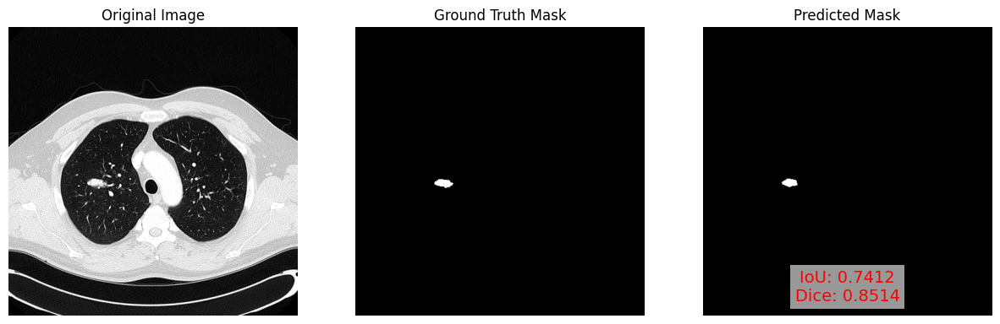

Ori: 0158_NI_slice141.npy. Mask: 0158_MA_slice141.npy. Predict: 0158_PD_slice141.npy
IoU: 0.6824, Dice Coefficient: 0.8112
LIDC-IDRI-0158 0158_PD_slice141.npy


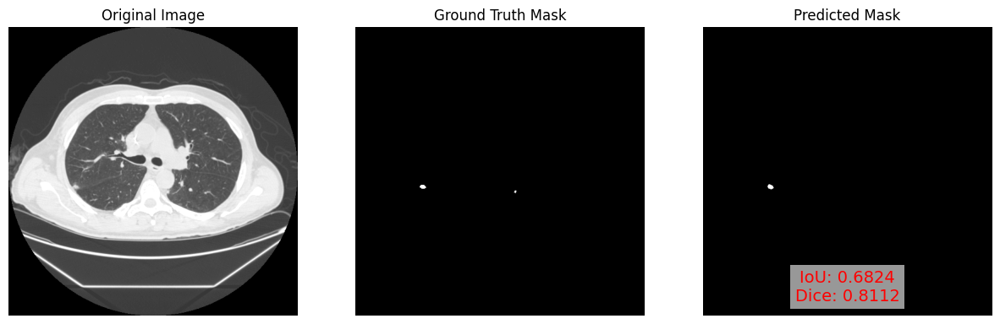

Ori: 0119_NI_slice161.npy. Mask: 0119_MA_slice161.npy. Predict: 0119_PD_slice161.npy
IoU: 0.9414, Dice Coefficient: 0.9698
LIDC-IDRI-0119 0119_PD_slice161.npy


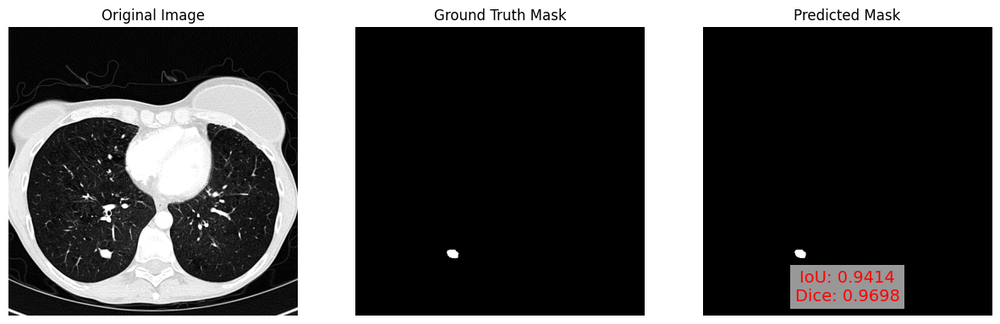

Ori: 0133_NI_slice041.npy. Mask: 0133_MA_slice041.npy. Predict: 0133_PD_slice041.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0133 0133_PD_slice041.npy


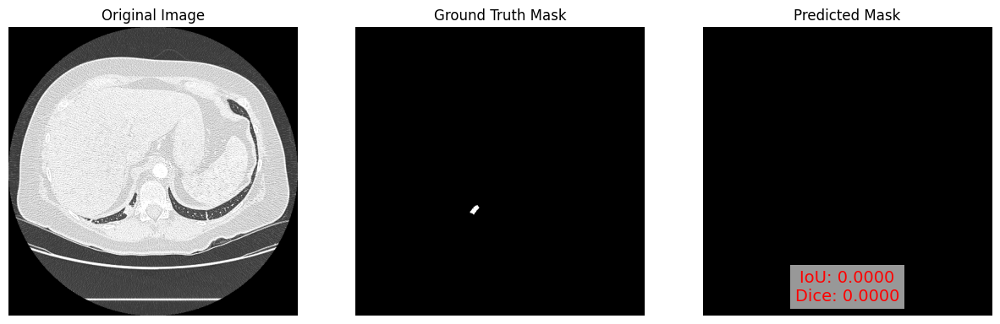

Ori: 0305_NI_slice144.npy. Mask: 0305_MA_slice144.npy. Predict: 0305_PD_slice144.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0305 0305_PD_slice144.npy


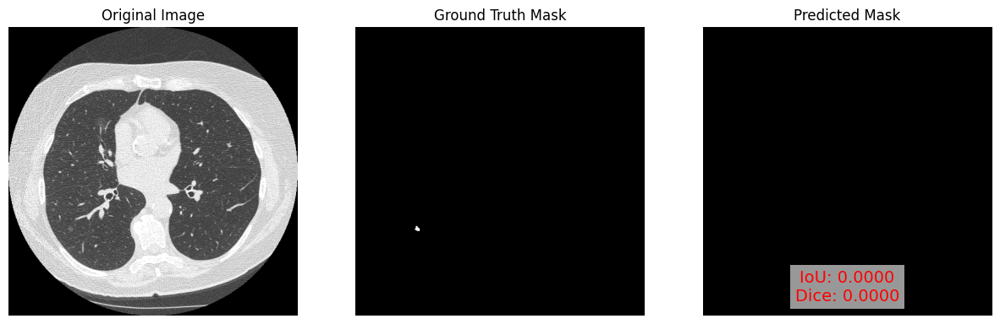

Ori: 0061_NI_slice093.npy. Mask: 0061_MA_slice093.npy. Predict: 0061_PD_slice093.npy
IoU: 0.6341, Dice Coefficient: 0.7761
LIDC-IDRI-0061 0061_PD_slice093.npy


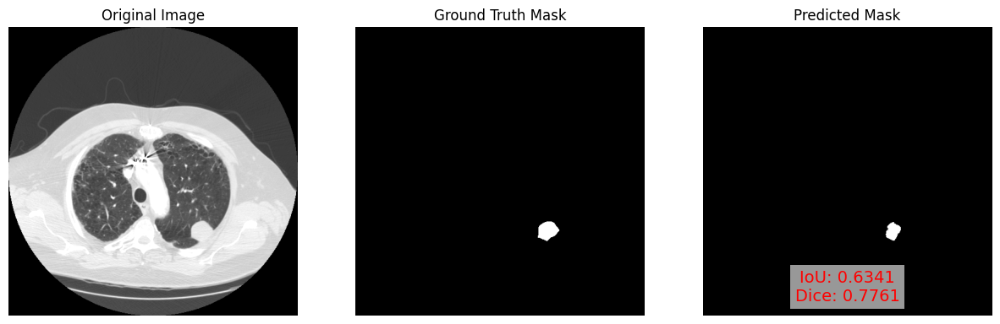

Ori: 0439_NI_slice079.npy. Mask: 0439_MA_slice079.npy. Predict: 0439_PD_slice079.npy
IoU: 0.6959, Dice Coefficient: 0.8207
LIDC-IDRI-0439 0439_PD_slice079.npy


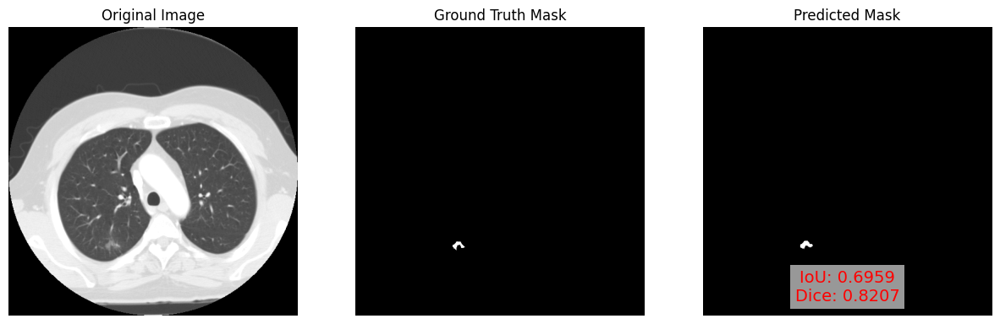

Ori: 0636_NI_slice277.npy. Mask: 0636_MA_slice277.npy. Predict: 0636_PD_slice277.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0636 0636_PD_slice277.npy


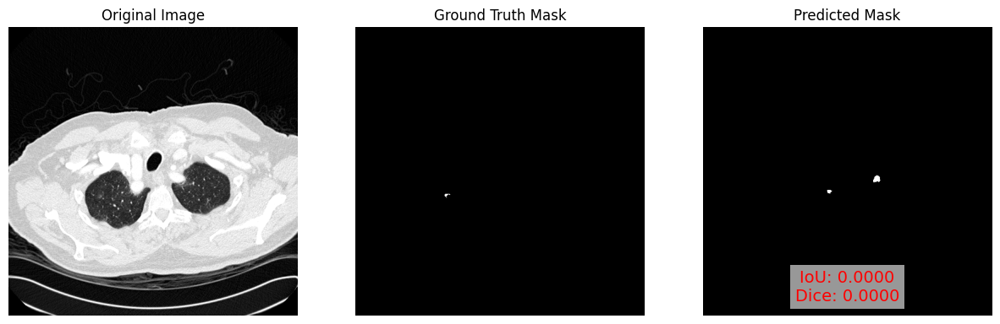

Ori: 0298_NI_slice212.npy. Mask: 0298_MA_slice212.npy. Predict: 0298_PD_slice212.npy
IoU: 0.0804, Dice Coefficient: 0.1488
LIDC-IDRI-0298 0298_PD_slice212.npy


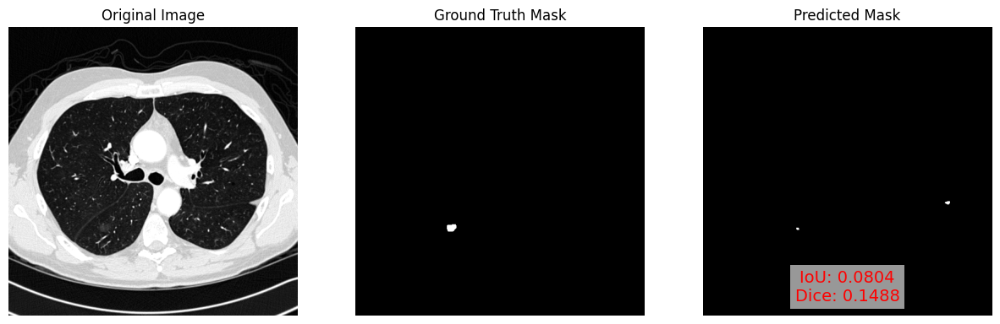

Ori: 0770_NI_slice160.npy. Mask: 0770_MA_slice160.npy. Predict: 0770_PD_slice160.npy
IoU: 0.8286, Dice Coefficient: 0.9063
LIDC-IDRI-0770 0770_PD_slice160.npy


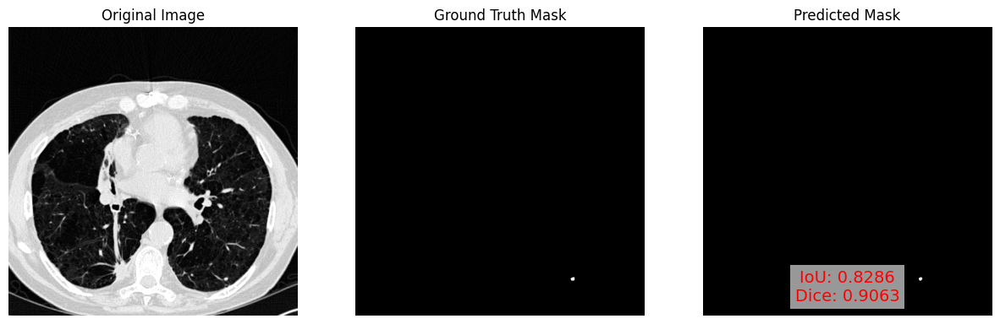

Ori: 0298_NI_slice291.npy. Mask: 0298_MA_slice291.npy. Predict: 0298_PD_slice291.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0298 0298_PD_slice291.npy


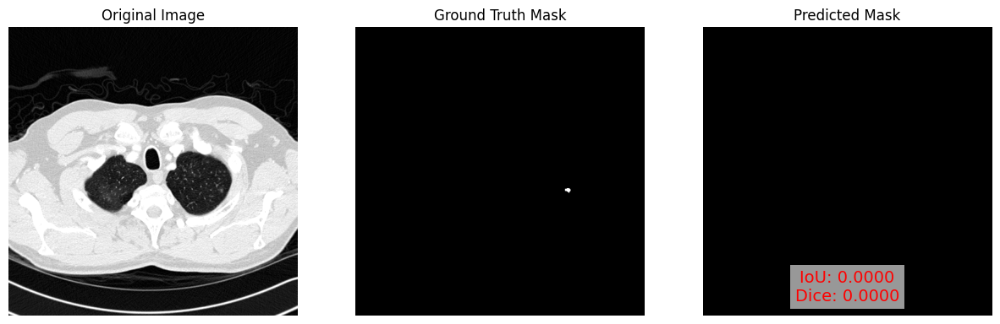

Ori: 0770_NI_slice178.npy. Mask: 0770_MA_slice178.npy. Predict: 0770_PD_slice178.npy
IoU: 0.8333, Dice Coefficient: 0.9091
LIDC-IDRI-0770 0770_PD_slice178.npy


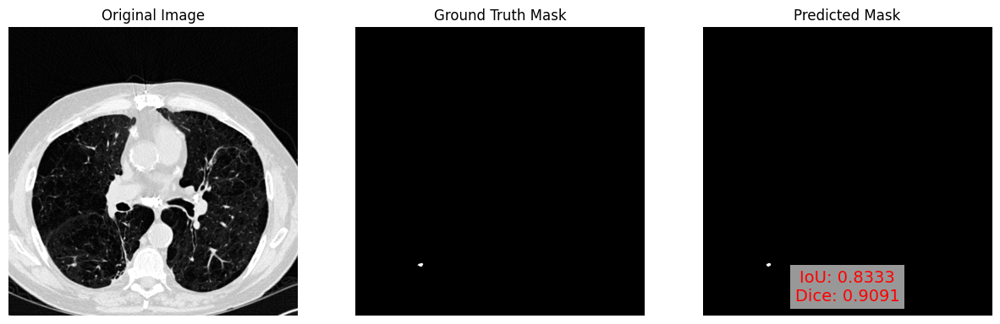

Ori: 0811_NI_slice255.npy. Mask: 0811_MA_slice255.npy. Predict: 0811_PD_slice255.npy
IoU: 0.2800, Dice Coefficient: 0.4375
LIDC-IDRI-0811 0811_PD_slice255.npy


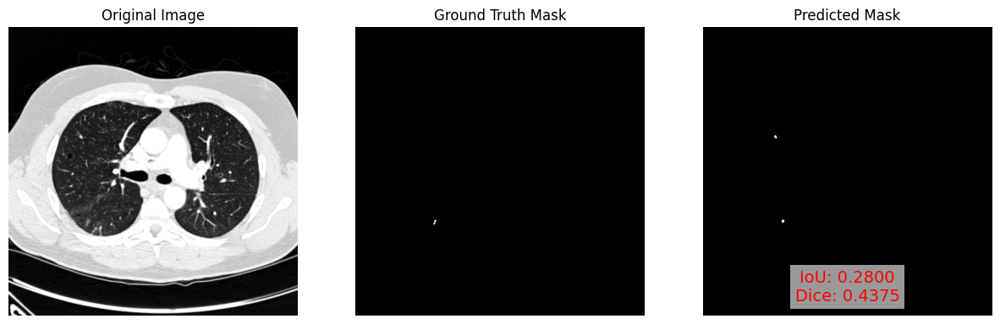

Ori: 0081_NI_slice102.npy. Mask: 0081_MA_slice102.npy. Predict: 0081_PD_slice102.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0081 0081_PD_slice102.npy


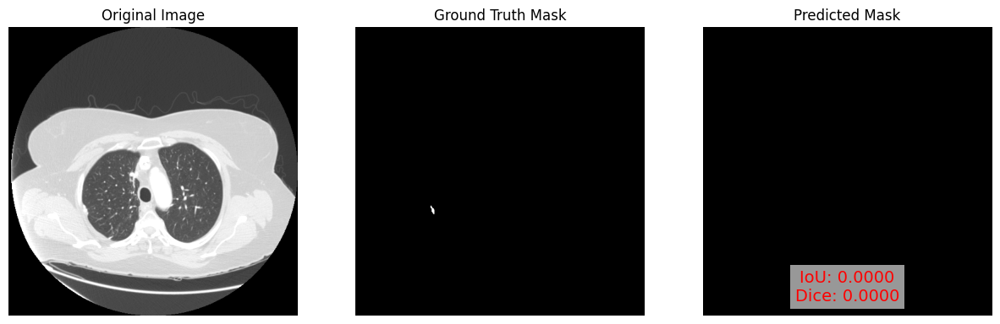

Ori: 0094_NI_slice305.npy. Mask: 0094_MA_slice305.npy. Predict: 0094_PD_slice305.npy
IoU: 0.8743, Dice Coefficient: 0.9330
LIDC-IDRI-0094 0094_PD_slice305.npy


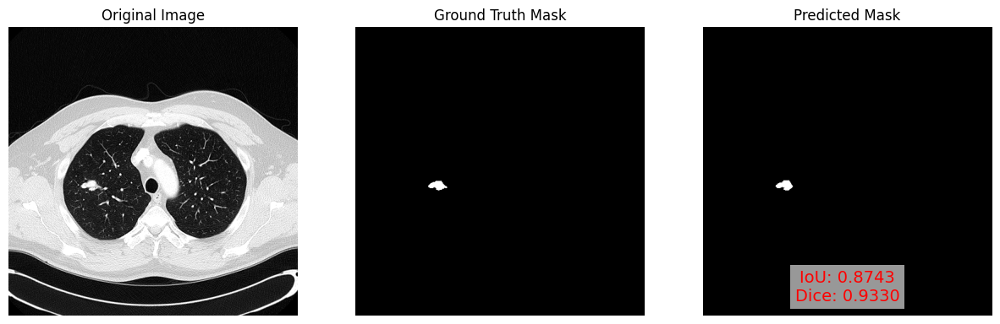

Ori: 0171_NI_slice041.npy. Mask: 0171_MA_slice041.npy. Predict: 0171_PD_slice041.npy
IoU: 0.8387, Dice Coefficient: 0.9123
LIDC-IDRI-0171 0171_PD_slice041.npy


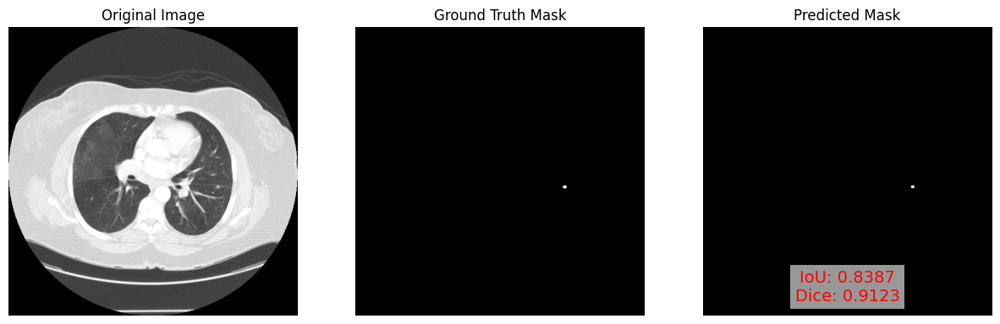

Ori: 0990_NI_slice160.npy. Mask: 0990_MA_slice160.npy. Predict: 0990_PD_slice160.npy
IoU: 0.6552, Dice Coefficient: 0.7917
LIDC-IDRI-0990 0990_PD_slice160.npy


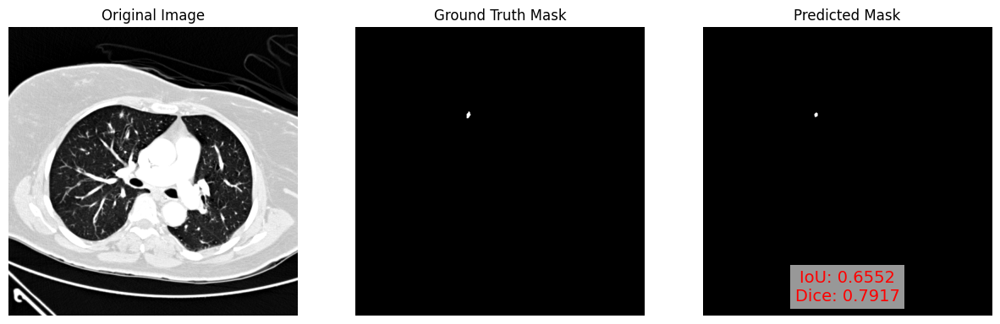

Ori: 0433_NI_slice113.npy. Mask: 0433_MA_slice113.npy. Predict: 0433_PD_slice113.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0433 0433_PD_slice113.npy


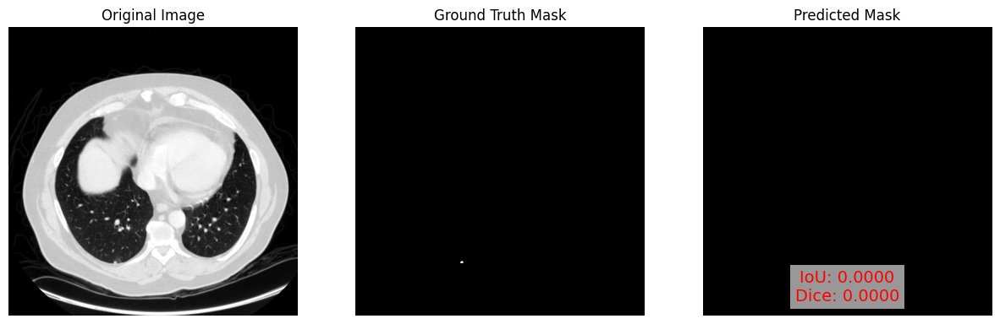

Ori: 0356_NI_slice074.npy. Mask: 0356_MA_slice074.npy. Predict: 0356_PD_slice074.npy
IoU: 0.7315, Dice Coefficient: 0.8449
LIDC-IDRI-0356 0356_PD_slice074.npy


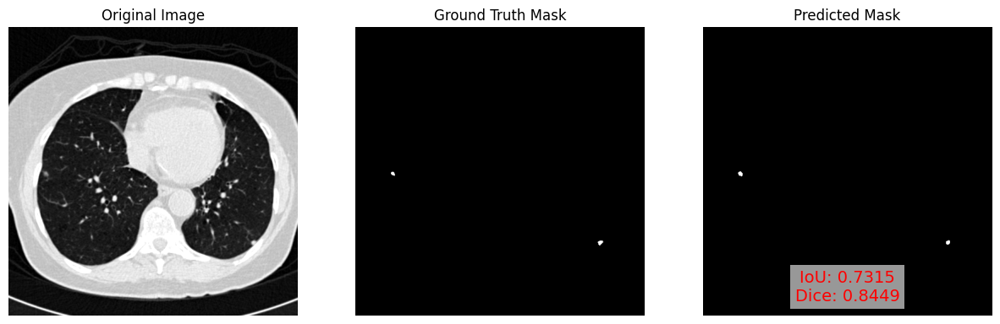

Ori: 0892_NI_slice044.npy. Mask: 0892_MA_slice044.npy. Predict: 0892_PD_slice044.npy
IoU: 0.8552, Dice Coefficient: 0.9220
LIDC-IDRI-0892 0892_PD_slice044.npy


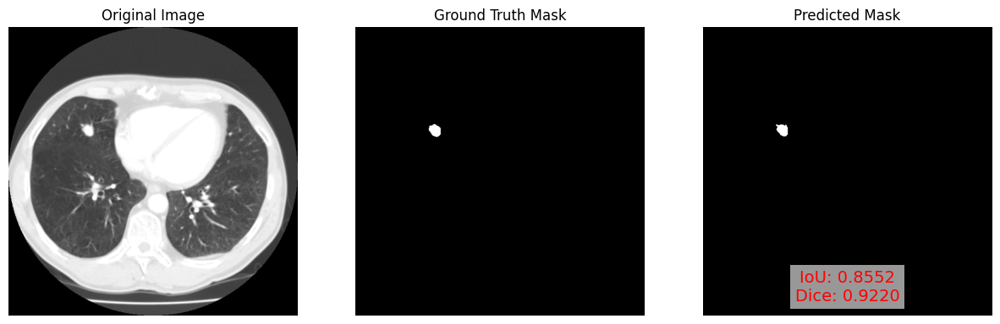

Ori: 0061_NI_slice087.npy. Mask: 0061_MA_slice087.npy. Predict: 0061_PD_slice087.npy
IoU: 0.8095, Dice Coefficient: 0.8947
LIDC-IDRI-0061 0061_PD_slice087.npy


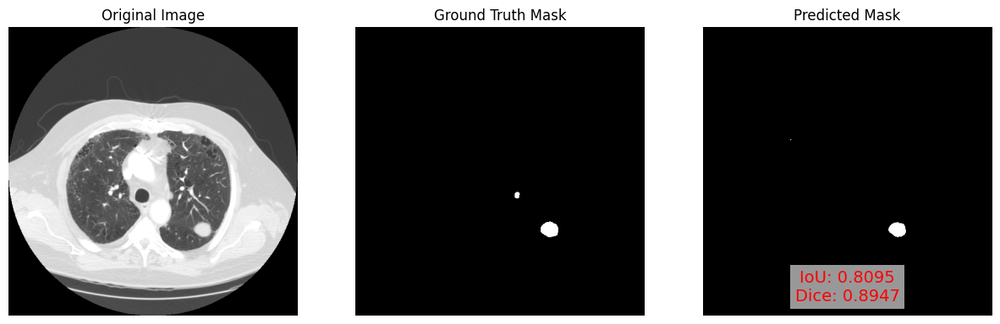

Ori: 0770_NI_slice218.npy. Mask: 0770_MA_slice218.npy. Predict: 0770_PD_slice218.npy
IoU: 0.7121, Dice Coefficient: 0.8319
LIDC-IDRI-0770 0770_PD_slice218.npy


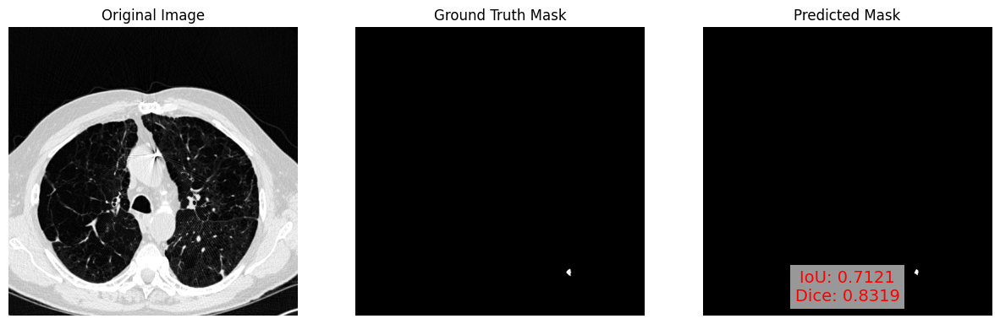

Ori: 0504_NI_slice056.npy. Mask: 0504_MA_slice056.npy. Predict: 0504_PD_slice056.npy
IoU: 0.4510, Dice Coefficient: 0.6216
LIDC-IDRI-0504 0504_PD_slice056.npy


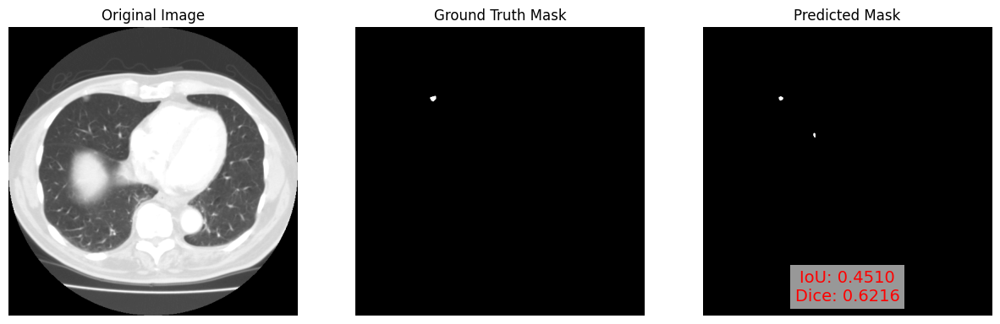

Ori: 0139_NI_slice031.npy. Mask: 0139_MA_slice031.npy. Predict: 0139_PD_slice031.npy
IoU: 0.4140, Dice Coefficient: 0.5856
LIDC-IDRI-0139 0139_PD_slice031.npy


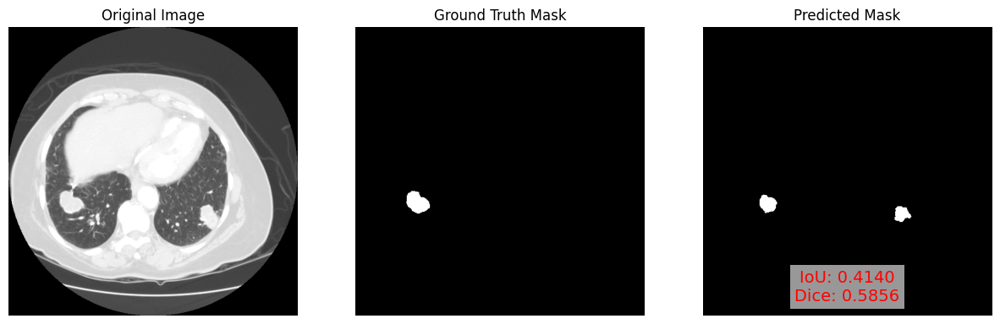

Ori: 0698_NI_slice339.npy. Mask: 0698_MA_slice339.npy. Predict: 0698_PD_slice339.npy
IoU: 0.5109, Dice Coefficient: 0.6763
LIDC-IDRI-0698 0698_PD_slice339.npy


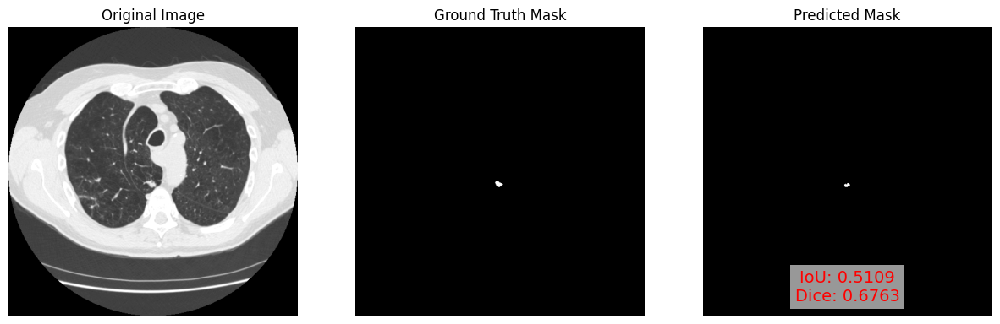

Ori: 0133_NI_slice134.npy. Mask: 0133_MA_slice134.npy. Predict: 0133_PD_slice134.npy
IoU: 0.5929, Dice Coefficient: 0.7444
LIDC-IDRI-0133 0133_PD_slice134.npy


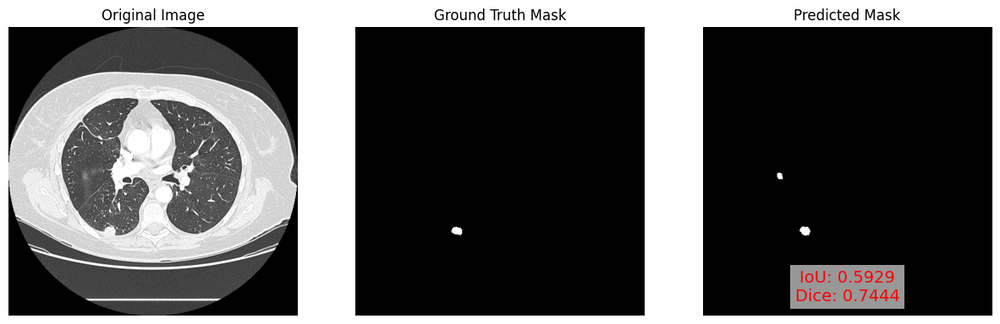

Ori: 0636_NI_slice151.npy. Mask: 0636_MA_slice151.npy. Predict: 0636_PD_slice151.npy
IoU: 0.4688, Dice Coefficient: 0.6383
LIDC-IDRI-0636 0636_PD_slice151.npy


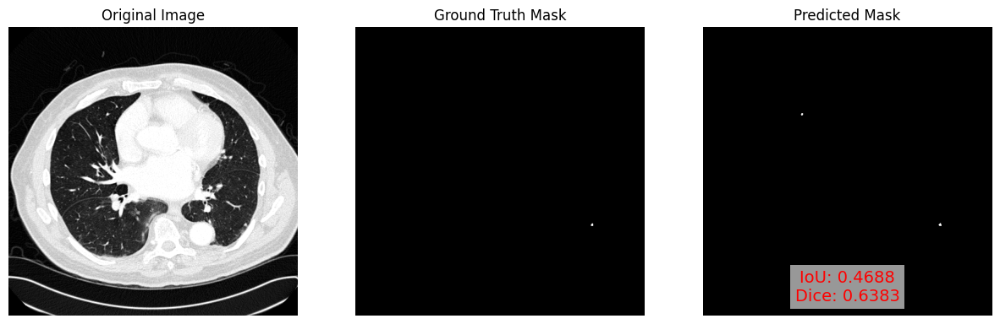

Ori: 0698_NI_slice348.npy. Mask: 0698_MA_slice348.npy. Predict: 0698_PD_slice348.npy
IoU: 0.4955, Dice Coefficient: 0.6627
LIDC-IDRI-0698 0698_PD_slice348.npy


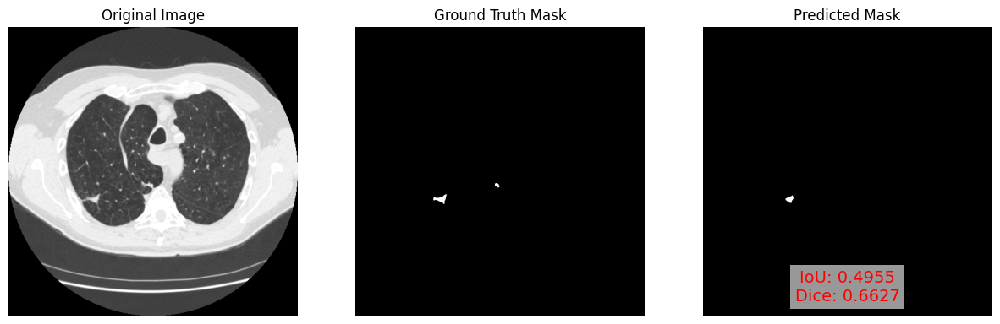

Ori: 0091_NI_slice152.npy. Mask: 0091_MA_slice152.npy. Predict: 0091_PD_slice152.npy
IoU: 0.8462, Dice Coefficient: 0.9167
LIDC-IDRI-0091 0091_PD_slice152.npy


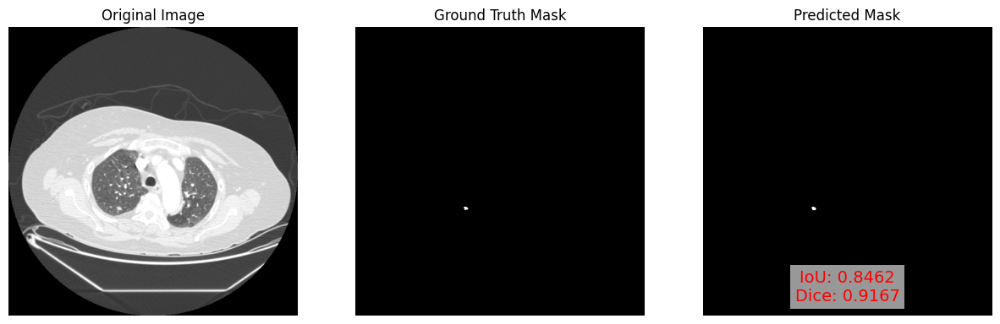

Ori: 0133_NI_slice043.npy. Mask: 0133_MA_slice043.npy. Predict: 0133_PD_slice043.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0133 0133_PD_slice043.npy


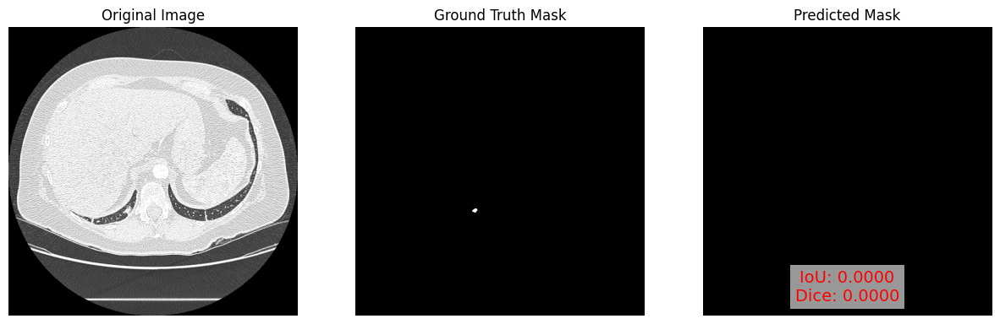

Ori: 0091_NI_slice102.npy. Mask: 0091_MA_slice102.npy. Predict: 0091_PD_slice102.npy
IoU: 0.9778, Dice Coefficient: 0.9888
LIDC-IDRI-0091 0091_PD_slice102.npy


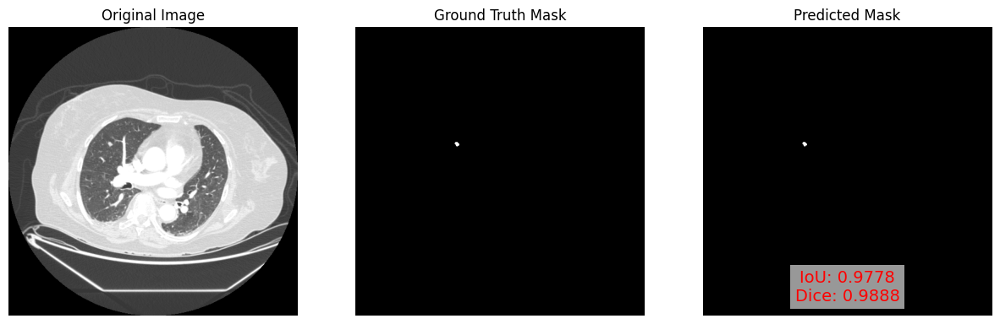

Ori: 0892_NI_slice042.npy. Mask: 0892_MA_slice042.npy. Predict: 0892_PD_slice042.npy
IoU: 0.8829, Dice Coefficient: 0.9378
LIDC-IDRI-0892 0892_PD_slice042.npy


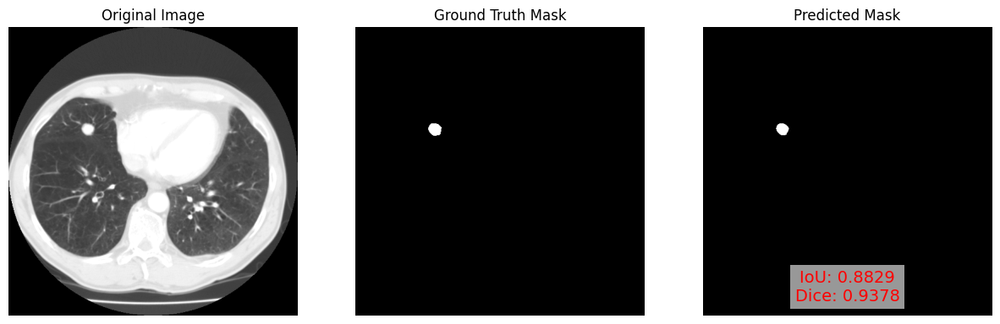

Ori: 0406_NI_slice296.npy. Mask: 0406_MA_slice296.npy. Predict: 0406_PD_slice296.npy
IoU: 0.3256, Dice Coefficient: 0.4912
LIDC-IDRI-0406 0406_PD_slice296.npy


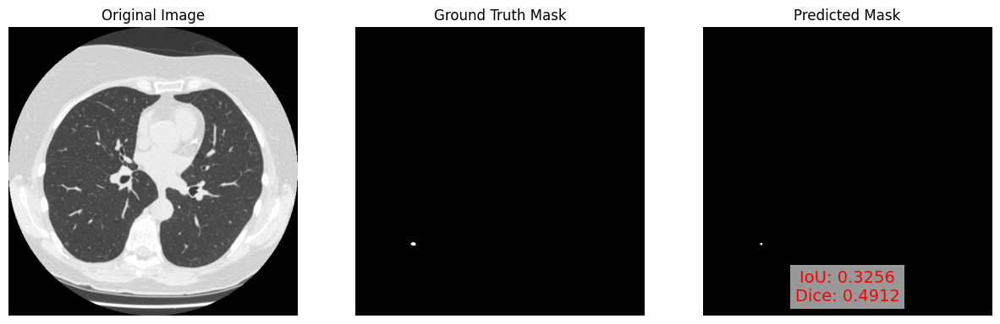

Ori: 0347_NI_slice071.npy. Mask: 0347_MA_slice071.npy. Predict: 0347_PD_slice071.npy
IoU: 0.8564, Dice Coefficient: 0.9226
LIDC-IDRI-0347 0347_PD_slice071.npy


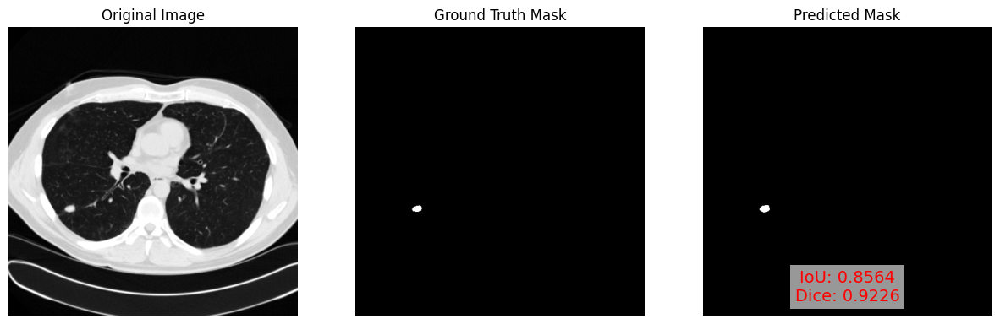

Ori: 0892_NI_slice085.npy. Mask: 0892_MA_slice085.npy. Predict: 0892_PD_slice085.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0892 0892_PD_slice085.npy


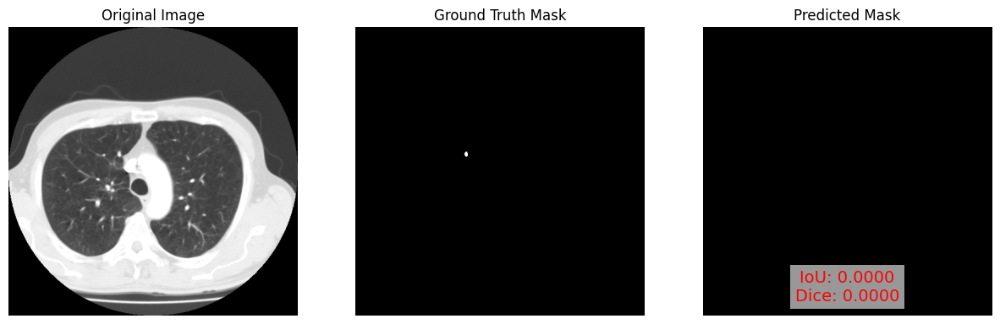

Ori: 0698_NI_slice365.npy. Mask: 0698_MA_slice365.npy. Predict: 0698_PD_slice365.npy
IoU: 0.7143, Dice Coefficient: 0.8333
LIDC-IDRI-0698 0698_PD_slice365.npy


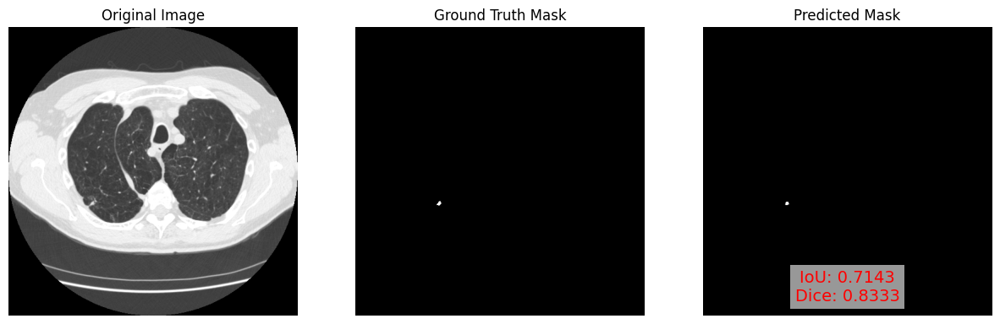

Ori: 0811_NI_slice236.npy. Mask: 0811_MA_slice236.npy. Predict: 0811_PD_slice236.npy
IoU: 0.8739, Dice Coefficient: 0.9327
LIDC-IDRI-0811 0811_PD_slice236.npy


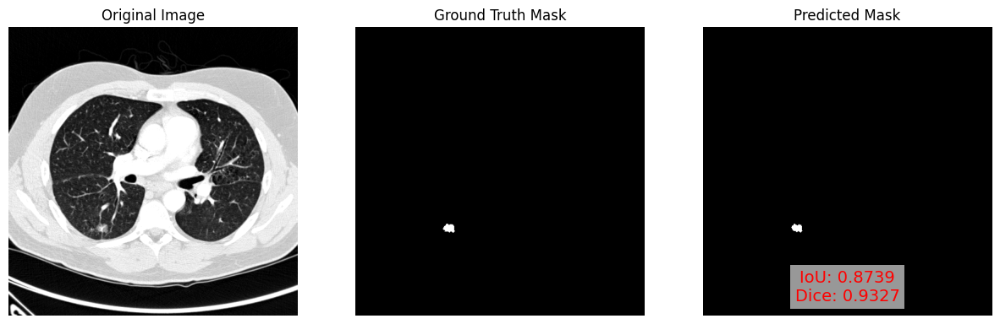

Ori: 0262_NI_slice112.npy. Mask: 0262_MA_slice112.npy. Predict: 0262_PD_slice112.npy
IoU: 0.7131, Dice Coefficient: 0.8325
LIDC-IDRI-0262 0262_PD_slice112.npy


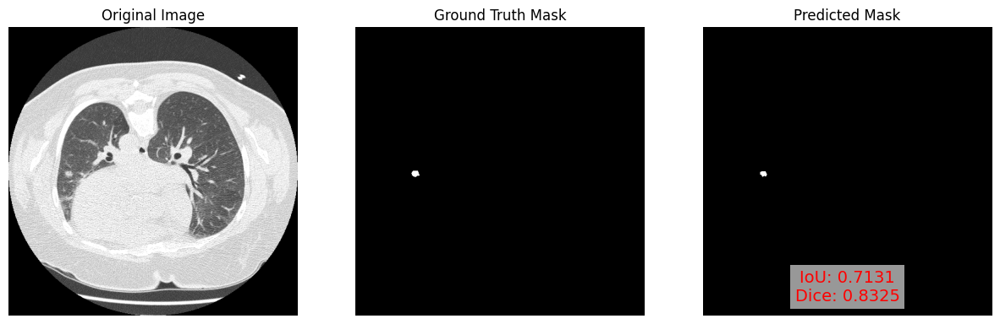

Ori: 0709_NI_slice069.npy. Mask: 0709_MA_slice069.npy. Predict: 0709_PD_slice069.npy
IoU: 0.9298, Dice Coefficient: 0.9636
LIDC-IDRI-0709 0709_PD_slice069.npy


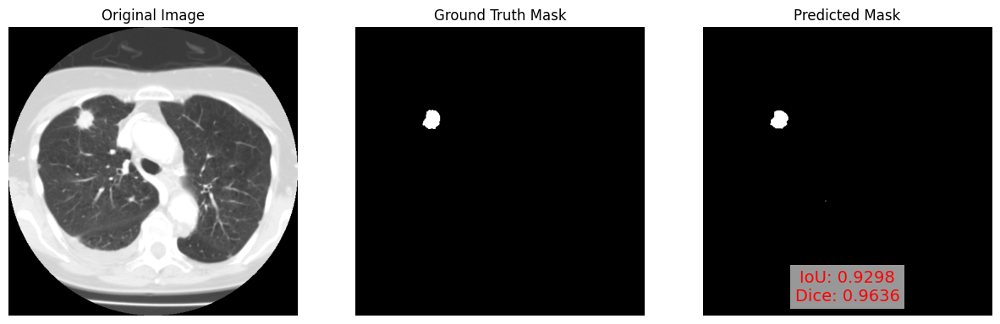

Ori: 0466_NI_slice070.npy. Mask: 0466_MA_slice070.npy. Predict: 0466_PD_slice070.npy
IoU: 0.0000, Dice Coefficient: 0.0000
LIDC-IDRI-0466 0466_PD_slice070.npy


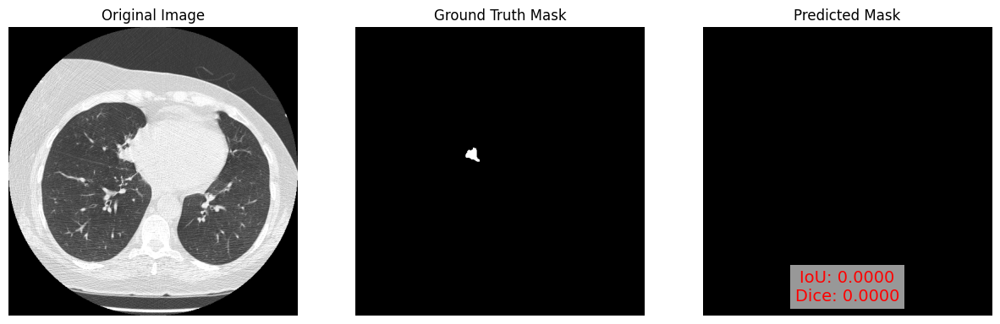

Ori: 0139_NI_slice044.npy. Mask: 0139_MA_slice044.npy. Predict: 0139_PD_slice044.npy
IoU: 0.7833, Dice Coefficient: 0.8785
LIDC-IDRI-0139 0139_PD_slice044.npy


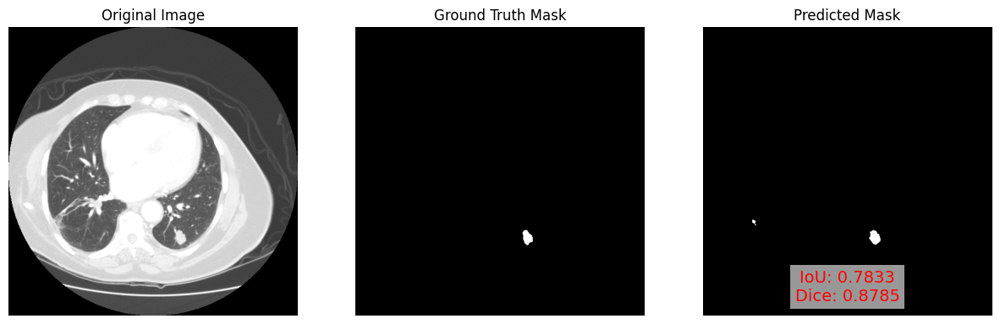

Ori: 0298_NI_slice210.npy. Mask: 0298_MA_slice210.npy. Predict: 0298_PD_slice210.npy
IoU: 0.2857, Dice Coefficient: 0.4444
LIDC-IDRI-0298 0298_PD_slice210.npy


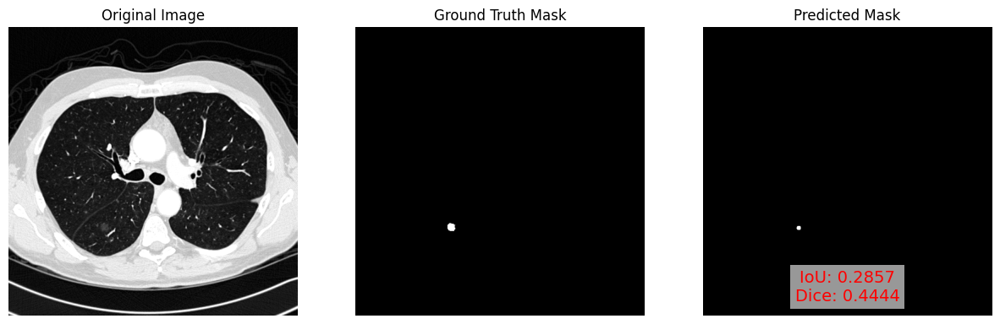

Ori: 0158_NI_slice144.npy. Mask: 0158_MA_slice144.npy. Predict: 0158_PD_slice144.npy
IoU: 0.4646, Dice Coefficient: 0.6345
LIDC-IDRI-0158 0158_PD_slice144.npy


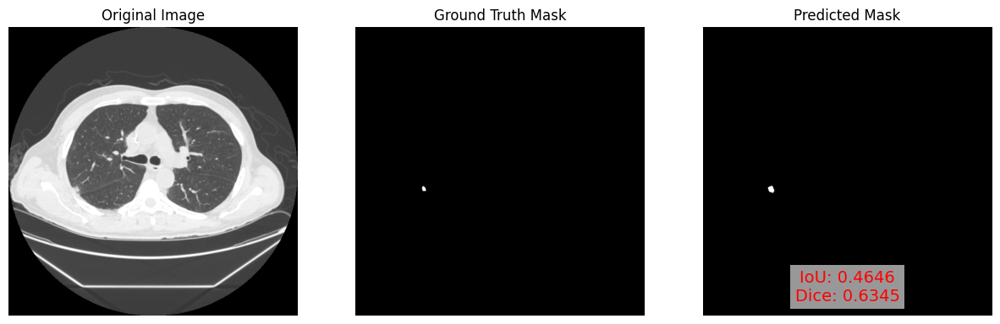

In [35]:
view_img(MASK_DIR,PREDICT_DIR,IMAGE_DIR)

Ori: 0383_CN_slice012.npy. Mask: 0383_CM_slice012.npy. Predict: 0383_CN_slice012.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0383 0383_CN_slice012.npy


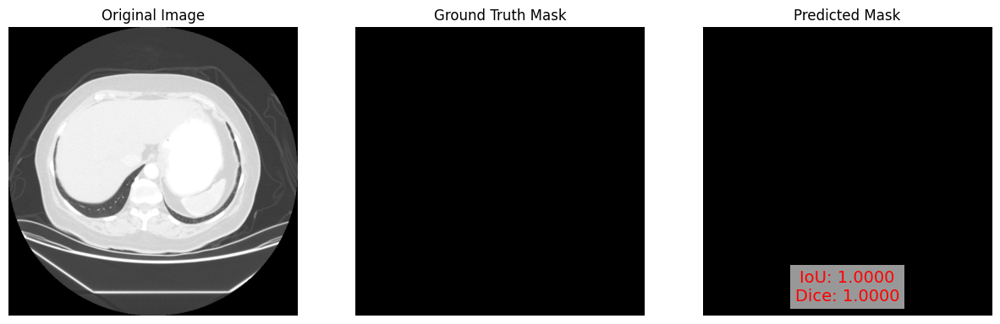

Ori: 0804_CN_slice004.npy. Mask: 0804_CM_slice004.npy. Predict: 0804_CN_slice004.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0804 0804_CN_slice004.npy


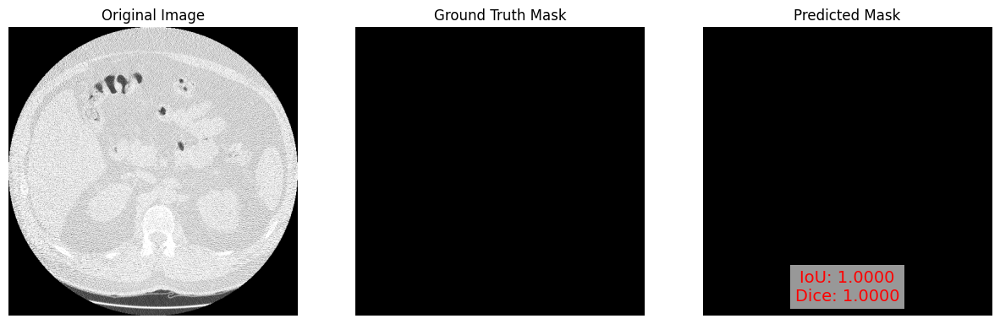

Ori: 0548_CN_slice015.npy. Mask: 0548_CM_slice015.npy. Predict: 0548_CN_slice015.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0548 0548_CN_slice015.npy


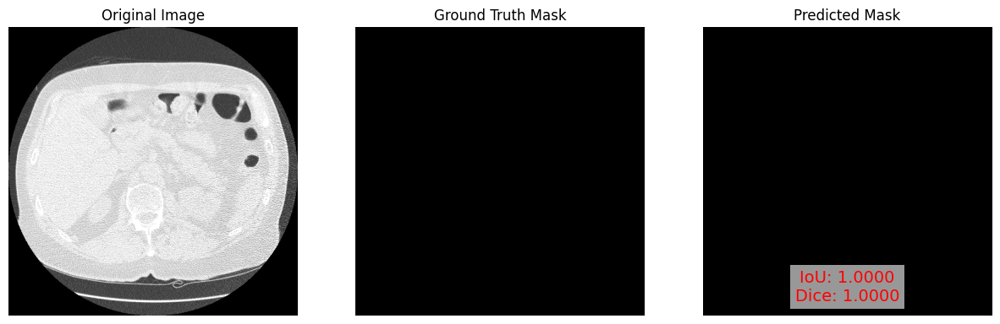

Ori: 0934_CN_slice016.npy. Mask: 0934_CM_slice016.npy. Predict: 0934_CN_slice016.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0934 0934_CN_slice016.npy


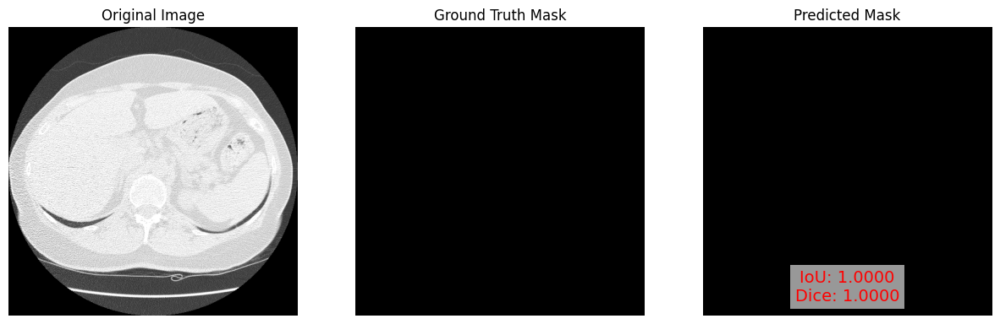

Ori: 0934_CN_slice005.npy. Mask: 0934_CM_slice005.npy. Predict: 0934_CN_slice005.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0934 0934_CN_slice005.npy


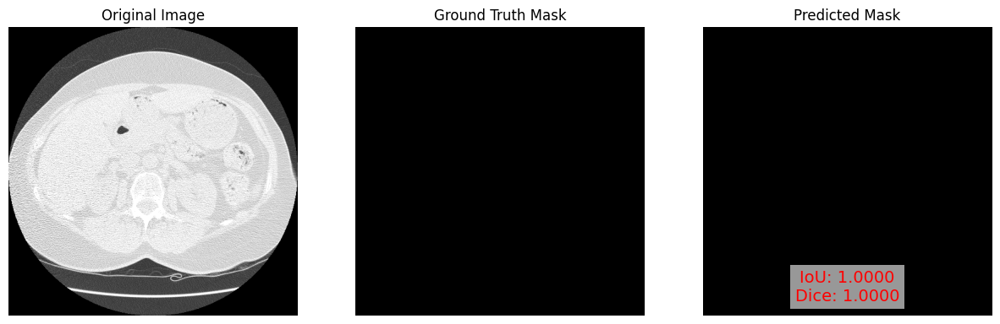

Ori: 0646_CN_slice024.npy. Mask: 0646_CM_slice024.npy. Predict: 0646_CN_slice024.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0646 0646_CN_slice024.npy


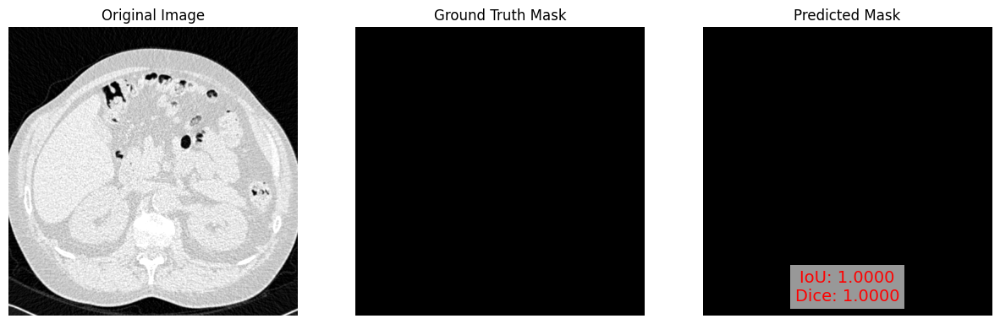

Ori: 0679_CN_slice004.npy. Mask: 0679_CM_slice004.npy. Predict: 0679_CN_slice004.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0679 0679_CN_slice004.npy


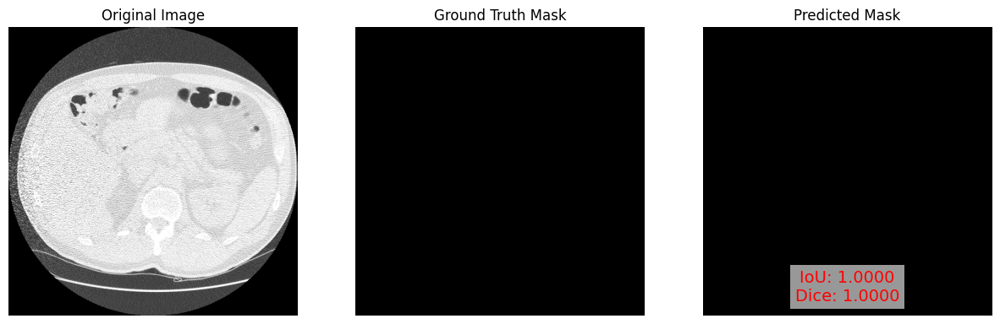

Ori: 0964_CN_slice044.npy. Mask: 0964_CM_slice044.npy. Predict: 0964_CN_slice044.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0964 0964_CN_slice044.npy


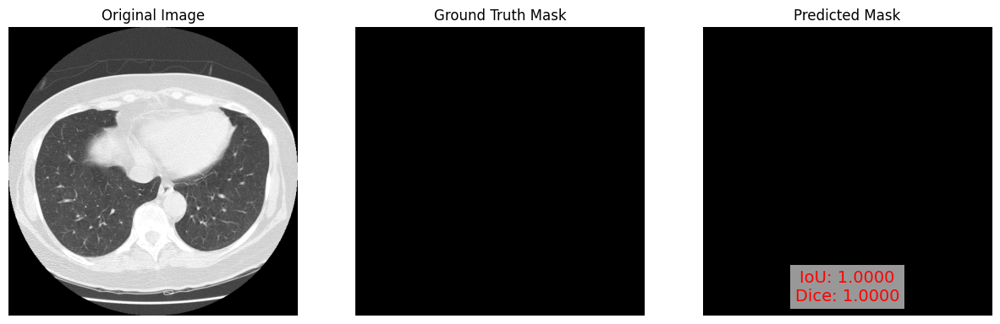

Ori: 0441_CN_slice036.npy. Mask: 0441_CM_slice036.npy. Predict: 0441_CN_slice036.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0441 0441_CN_slice036.npy


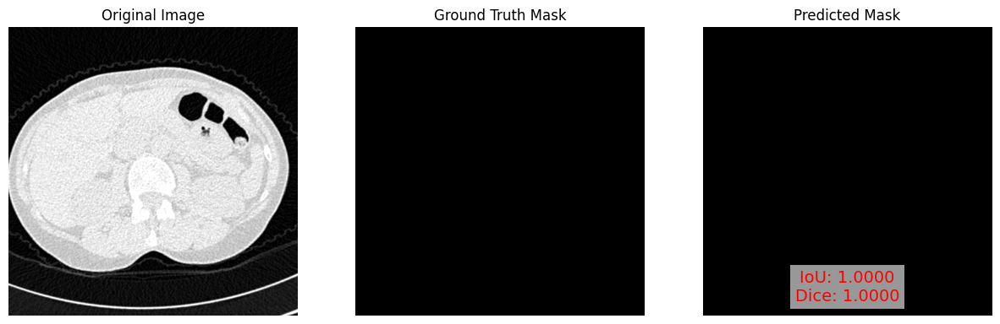

Ori: 0804_CN_slice000.npy. Mask: 0804_CM_slice000.npy. Predict: 0804_CN_slice000.npy
IoU: 1.0000, Dice Coefficient: 1.0000
LIDC-IDRI-0804 0804_CN_slice000.npy


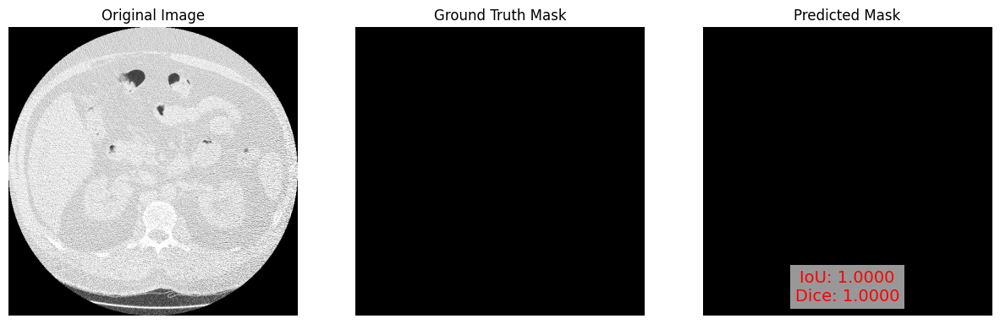

In [36]:
view_img_clean(CLEAN_DIR_MASK, CLEAN_PREDICT_DIR, CLEAN_DIR_IMG)

0008_PD001_slice002.npy

In [15]:
original = np.load(IMAGE_DIR+'/LIDC-IDRI-0008/0008_NI001_slice002.npy')
predict = np.load(PREDICT_DIR+'/0008_PD001_slice002.npy')
answer = np.load(MASK_DIR+'/LIDC-IDRI-0008/0008_MA001_slice002.npy')

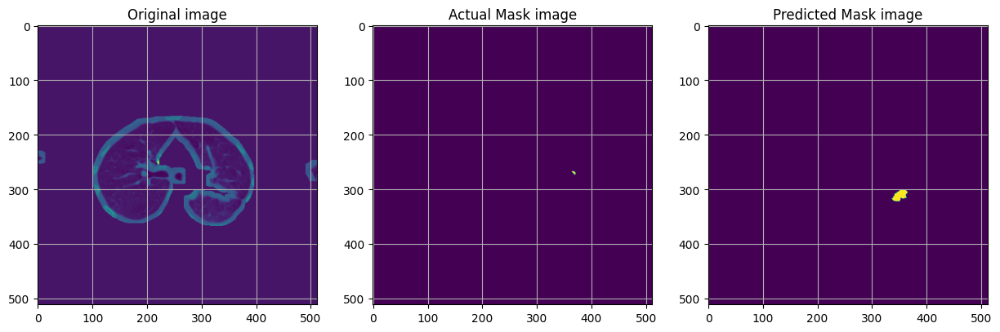

In [16]:
fig,ax = plt.subplots(1,3, figsize=(15,15))
ax[0].title.set_text('Original image')
ax[0].imshow(original)
ax[0].grid()
ax[1].title.set_text('Actual Mask image')
ax[1].imshow(answer)
ax[1].grid()
ax[2].title.set_text('Predicted Mask image')
ax[2].imshow(predict)
ax[2].grid()
plt.savefig("prediction_distance_comparison.png",dpi=300)
plt.show()

In [17]:
ndi.center_of_mass(predict)[0]==np.nan

False

In [18]:
np.isnan(ndi.center_of_mass(predict)[0])

False

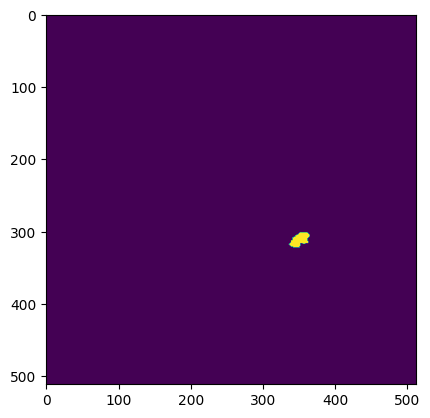

In [19]:
plt.imshow(predict)

In [20]:
s = generate_binary_structure(2,2)

In [21]:
labeled_array, num_features = label(predict, structure=s)

In [22]:
num_features

1

In [23]:
labeled_array

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [24]:
n=1
lab=np.array(labeled_array)
lab[lab!=(n+1)]=0
lab[lab==(n+1)]=1

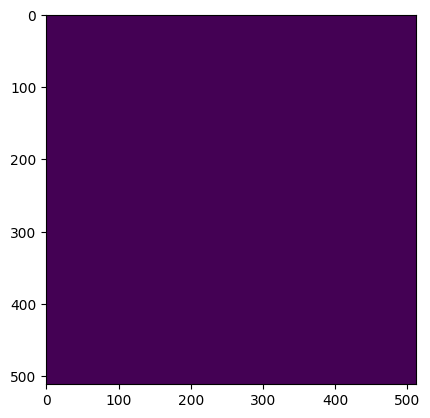

In [25]:
plt.imshow(lab)

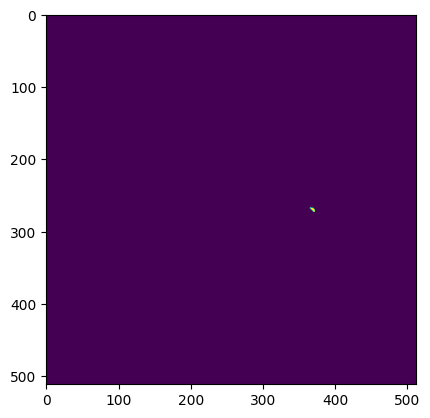

In [26]:
plt.imshow(answer)

In [27]:
np.sum(lab)

0

In [28]:
com= ndi.center_of_mass(lab)
com

/home/nckusoc/Documents/Devin-Journal/manifest-1721718306896/.venv/lib/python3.8/site-packages/scipy/ndimage/_measurements.py:1534: RuntimeWarning: invalid value encountered in scalar divide
  results = [sum(input * grids[dir].astype(float), labels, index) / normalizer


(nan, nan)

In [29]:
com_answer= ndi.center_of_mass(answer)

In [30]:
com_answer

(269.92, 368.6)

In [31]:
np.linalg.norm(np.array(com)-np.array(com_answer),2)

nan

In [34]:
def calculate_fp(prediction_dir,mask_dir,distance_threshold=80):
    """This calculates the fp by comparing the predicted mask and orginal mask"""
    # TP,TN,FP,FN
    # FN will always be zero here as all the mask contains a nodule
    confusion_matrix =[0,0,0,0]
    s = generate_binary_structure(2,2)
    for prediction in os.listdir(PREDICT_DIR)[:10]:
        # print(confusion_matrix)
        pid = 'LIDC-IDRI-'+prediction[:4]
        mask_id = prediction.replace('PD','MA')
        mask = np.load(mask_dir+'/'+pid+'/'+mask_id)
        predict = np.load(prediction_dir + "/" + prediction)
        answer_com = np.array(ndi.center_of_mass(mask))
        # Patience is used to check if the patch has cropped the same image
        patience =0
        labeled_array, nf = label(predict, structure=s)
        if nf>0:
            for n in range(nf):
                lab=np.array(labeled_array)
                lab[lab!=(n+1)]=0
                lab[lab==(n+1)]=1
                predict_com=np.array(ndi.center_of_mass(labeled_array))
                if np.linalg.norm(predict_com-answer_com,2) < distance_threshold:
                    if patience != 0:
                        # print("HIT")
                        continue
                    # add true positive
                    confusion_matrix[0]+=1
                    patience +=1
                else:
                    confusion_matrix[2]+=1

        else:
            # Add True Negative since the UNET didn't detect a cancer even when there was one
            confusion_matrix[1]+=1

    return confusion_matrix

    # [1848, 719, 1309, 0]

In [35]:
confusion_matrix = calculate_fp(PREDICT_DIR,MASK_DIR,distance_threshold=60)

In [36]:
confusion_matrix

[8, 2, 0, 0]

In [37]:
confusion_matrix =[0,0,0,0]

In [38]:
np.sum(testing)

NameError: name 'testing' is not defined

In [ ]:
ndi.center_of_mass(mask)

(197.53549517966695, 111.64504820333042)

In [ ]:
ndi.center_of_mass(predict)

(197.27844073598493, 119.18674498223672)

In [ ]:
def crop_patch(image,mask):
    return crop_nodule(ndi.center_of_mass(mask),image)
    

In [ ]:
patch= crop_patch(original,mask)

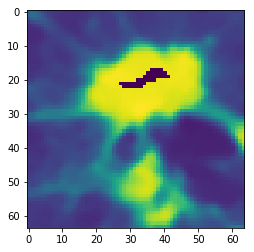

In [ ]:
plt.imshow(patch)

In [ ]:
from scipy import signal

xder = np.array([[-1,0,1],[-2,0,2],[-1,0,1]])
yder = np.array([[1,2,1],[0,0,0],[-1,-2,-1]])
smooth = np.array([[1,1,1],[1,5,1],[1,1,1]])
xder2 = np.array([[-1,2,-1],[-3,6,-3],[-1,2,-1]])
yder2 = np.array([[-1,-3,-1],[2,6,2],[-1,-3,-1]])

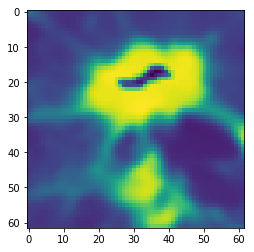

In [ ]:
plt.imshow(signal.convolve2d(patch,smooth,mode='valid'))

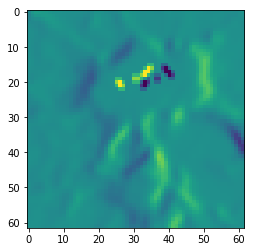

In [ ]:
plt.imshow(signal.convolve2d(patch,xder,mode='valid'))

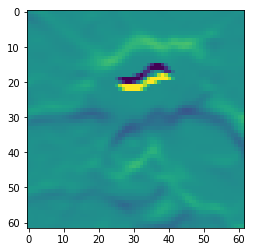

In [ ]:
plt.imshow(signal.convolve2d(patch,yder,mode='valid'))

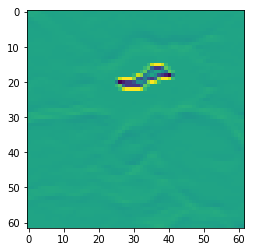

In [ ]:
plt.imshow(signal.convolve2d(patch,yder2,mode='valid'))

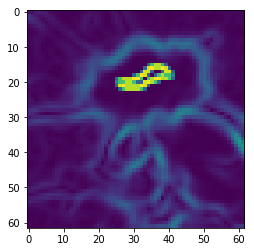

In [ ]:
arrx = signal.convolve2d(patch,xder,mode='valid')
arry = signal.convolve2d(patch,yder,mode='valid')
plt.imshow(np.hypot(arrx,arry))

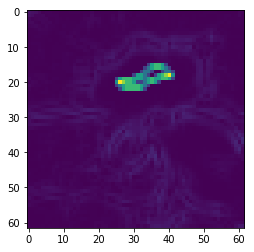

In [ ]:
arrx = signal.convolve2d(patch,xder2,mode='valid')
arry = signal.convolve2d(patch,yder2,mode='valid')
plt.imshow(np.hypot(arrx,arry))

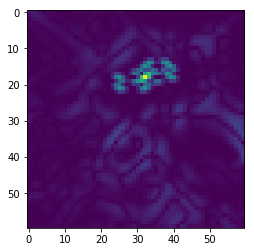

In [ ]:
arrx = signal.convolve2d(patch,xder,mode='valid')
arry = signal.convolve2d(patch,yder,mode='valid')
arrx = signal.convolve2d(arrx,yder,mode='valid')
arry = signal.convolve2d(arry,xder,mode='valid')
plt.imshow(np.hypot(arrx,arry))

In [ ]:
def create_tp_coordinates(mask_answer_dir,patient_list):
    """ Creates dataframe storing TP coordinates"""
    df= pd.DataFrame(index=[],columns= ['file_name','nodule_no','tp_x_coord','tp_y_coord'])
    
    for file in patient_list:
        mask = np.load(mask_answer_dir+file)        
        try:
            com = ndi.center_of_mass(mask)
            tmp = pd.Series([file,1,int(com[1]),int(com[0])],index=['file_name','nodule_no','tp_x_coord','tp_y_coord'])
            df = df.append(tmp,ignore_index=True)
        except ValueError:
            #ValueError occurs because the answer sheet doesn't contain any nodule
            #There are answer sheet like these because the U-Net predicted there is a nodule
            continue
            
    return df